# RateMyProfessor Dataset: Preprocessing and Exploratory Data Analysis

This Jupyter Notebook details the data preprocessing and exploratory data analysis (EDA) performed on a RateMyProfessors (RMP) dataset.  The dataset contains over 1.4 million student reviews, offering a rich resource for investigating potential biases, understanding student sentiment, and uncovering prevalent themes in feedback.  This project utilizes various advanced techniques and libraries including SpaCy for text preprocessing, Gensim for topic modeling, and Plotly for interactive visualizations. The notebook is structured to provide a clear and comprehensive walkthrough, suitable even for those new to data analysis or this specific dataset. 

---

## Table of Contents

1. [Environment Setup](#environment-setup)
2. [Data Loading and Initial Exploration](#data-loading-and-initial-exploration)
3. [Data Cleaning and Preprocessing](#data-cleaning-and-preprocessing)
    - [Handling Missing Values](#handling-missing-values)
    - [Deduplication](#deduplication)
    - [Data Type Corrections](#data-type-corrections)
4. [Feature Engineering](#feature-engineering)
    - [Professor Gender Assignment](#professor-gender-assignment)
    - [Department Mapping to Disciplines](#department-mapping-to-disciplines)
5. [Text Preprocessing and Sentiment Label Generation](#text-preprocessing-and-sentiment-label-generation)
6. [Exploratory Statistical Analysis](#exploratory-statistical-analysis)
    - [Descriptive Statistics](#descriptive-statistics)
    - [Correlation Analysis](#correlation-analysis)
    - [Group Comparisons (Disciplines and Ratings)](#group-comparisons-disciplines-and-ratings)
    - [Hypothesis Testing (Gender and Ratings)](#hypothesis-testing-gender-and-ratings)
    - [Two-Way ANOVA (Gender, Discipline, and Ratings)](#two-way-anova-gender-discipline-and-ratings)
    - [Departmental Bias Analysis](#departmental-bias-analysis)
    - [Tukey's HSD Test for Post-Hoc Analysis](#tukeys-hsd-test-for-post-hoc-analysis)

7. [In-Depth Sentiment Analysis](#in-depth-sentiment-analysis)
    - [Sentiment Analysis Using Unigrams and Bigrams](#sentiment-analysis-using-unigrams-and-bigrams)
    - [Sentiment Analysis Using Opinion Lexicon](#sentiment-analysis-using-opinion-lexicon)
    - [Sentiment Analysis Using VADER](#sentiment-analysis-using-vader)
    - [Generating Word Clouds for Sentiment Terms](#generating-word-clouds-for-sentiment-terms)
    - [Biased Term Analysis (VADER & LEXICON)](#biased-term-analysis-vader-lexicon)

8. [Bias Detection](#bias-detection)
    - [Gender Bias in Ratings](#gender-bias-in-ratings)
    - [Gender Distribution in Top/Bottom Disciplines](#gender-distribution-in-top-bottom-disciplines)
    - [Gender and Average Ratings in Top/Bottom Disciplines](#gender-and-average-ratings-in-top-bottom-disciplines) 

9. [Topic Modeling of Student Comments](#topic-modeling-of-student-comments)
10. [Conclusion](#conclusion)

---

<a id='environment-setup'></a>
## 1. Environment Setup

This section installs and imports the necessary Python libraries. We'll be using:
* **pandas:** For data manipulation and analysis.
* **SpaCy:** For advanced text preprocessing.
* **NLTK:** For natural language processing tasks.
* **Gensim:** For topic modeling.
* **Plotly:** For creating interactive visualizations.
* **Other Libraries:** Various utility libraries for statistical analysis, visualization enhancements, fuzzy matching, etc.

In [1]:
# # Install necessary libraries
# %pip install spacy -q
# !python -m spacy download en_core_web_sm
# %pip install gensim -q
# %pip install plotly -q
# %pip install scikit-learn -q
# %pip install pyLDAvis -q
# %pip install pandas-profiling[notebook] -q
# %pip install rapidfuzz -q
# %pip install gender-guesser -q

# Data Processing and Manipulation
import pandas as pd
from collections import Counter
import ace_tools_open as tools
import numpy as np


# Visualization
# For Matplotlib and Seaborn
%matplotlib inline

# For Plotly
import plotly.io as pio
pio.renderers.default = "notebook"  # Use "notebook" for inline display
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# Text Processing and NLP
import spacy
from nltk.corpus import stopwords
from nltk.util import ngrams
import contractions
import unicodedata
import re
import gender_guesser.detector as gender

# Machine Learning and Statistical Analysis

from scipy.stats import ttest_ind
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import torch
from torch.utils.data import Dataset, DataLoader

# Topic Modeling
import gensim
from gensim import corpora
from gensim.models import LdaMulticore, CoherenceModel
import pyLDAvis
import pyLDAvis.gensim_models

# Utility Libraries
import warnings
import rapidfuzz as fuzz
import ast
import pickle
from tqdm import tqdm
import gc

# Suppress warnings
warnings.filterwarnings('ignore')

# Initialize spaCy and device
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
english_stop_words = set(stopwords.words('english'))

---
<a id='data-loading-and-initial-exploration'></a>
## 2. Data Loading and Initial Exploration

Here, we load the RateMyProfessor dataset into a pandas DataFrame. The code also configures the visual style for plots using Seaborn.

In [2]:
# Load Data
df = pd.read_csv("professors_75346.csv")
# Configure visualization aesthetics
sns.set(style="whitegrid")
plt.rcParams.update({'figure.max_open_warning': 0})

In [3]:
 #Initial data exploration using pandas functions
tools.display_dataframe_to_user(name="RateMyProfessors SET Data", dataframe=df)

RateMyProfessors SET Data


In [4]:
# Summary Statistics
tools.display_dataframe_to_user(name="Summary Statistics", dataframe=df.describe(include='all').transpose())

Summary Statistics


In [5]:
# Checking for Missing Values
missing_values = df.isnull().sum()
missing_percentage = (missing_values / len(df)) * 100
missing_df = pd.DataFrame({'Missing Values': missing_values, 'Percentage (%)': missing_percentage})
missing_df = missing_df[missing_df['Missing Values'] > 0].sort_values(by='Missing Values', ascending=False)
display(missing_df)

# Delete variables to clear memory and collect garbage
del missing_values, missing_percentage, missing_df
gc.collect()

,Missing Values,Percentage (%)
rating_attendanceMandatory,563065,37.365288
school_city,70400,4.671781
school_state,70400,4.671781
rating_textbookUse,35274,2.340801
rating_comment,99,0.006570
rating_class,25,0.001659


264

---
<a id='data-cleaning-and-preprocessing'></a>
## 3. Data Cleaning and Preprocessing

This section focuses on cleaning and preparing the data for analysis. This involves handling missing values, removing duplicate entries, correcting data types, and selecting relevant columns.

<a id='handling-missing-values'></a>
### A. Handling Missing Values

Missing values in the 'rating_class' column are imputed using the mode (most frequent value).

In [6]:
df = df[['professor_id', 'department', 'first_name', 'last_name','would_take_again_percent', 'avg_rating', 'rating_comment',
       'rating_flagStatus',
       'rating_class', 'rating_helpfulRating', 'rating_clarityRating',
       'rating_isForOnlineClass', 'rating_difficultyRating', 'rating_isForCredit'
       ]]

# Replace missing values in 'rating_class' with the mode
mode_rating_class = df['rating_class'].mode()[0]
df['rating_class'].fillna(mode_rating_class, inplace=True)
# Drop rows where 'rating_comment' is missing
df = df.dropna(subset=['rating_comment'])

# Verify that there are no more missing values
missing_values_after = df.isnull().sum()
missing_df_after = pd.DataFrame({'Missing Values': missing_values_after, 'Percentage (%)': (missing_values_after / len(df)) * 100})
missing_df_after = missing_df_after[missing_df_after['Missing Values'] > 0].sort_values(by='Missing Values', ascending=False)
display(missing_df_after)

# Delete variables to clear memory and collect garbage
del mode_rating_class, missing_values_after, missing_df_after
gc.collect()


,Missing Values,Percentage (%)


0

In [7]:
# Domain-specific stop words
# Core academic role/setting words (these don't add analytical value)
domain_stop_words = {
    'professor', 'prof', 'teacher', 'lecturer', 'student', 'class', 'course', 'lecture', 'dr', 
    'section', 'ratemyprofessor', 'rmp', 'review', 'rating', 'comment', 'feedback'
}

stop_words =  english_stop_words.union(domain_stop_words)

<a id='deduplication'></a>
### B. Deduplication

Duplicate rows and duplicate comments are removed to ensure data integrity and prevent overrepresentation of certain reviews.

In [8]:
print(f"Initial DataFrame shape: {df.shape}")
df.drop_duplicates(inplace=True)
print(f"Shape after dropping duplicate rows: {df.shape}")
df.drop_duplicates(subset='rating_comment', inplace=True)
print(f"Shape after dropping duplicates based on 'rating_comment': {df.shape}")

Initial DataFrame shape: (1506821, 14)
Shape after dropping duplicate rows: (1506185, 14)
Shape after dropping duplicates based on 'rating_comment': (1492703, 14)


In [9]:
tools.display_dataframe_to_user(name="Summary Statistics", dataframe=df.describe(include='all').transpose())

Summary Statistics


<a id='data-type-corrections'></a>
### C. Data Type Corrections

The `professor_id` is converted to string type to ensure consistency and avoid potential issues with numerical operations on IDs.

In [10]:
# Ensure 'professor_id' is of type string
df['professor_id'] = df['professor_id'].astype(str)
# Verify data types
print("\nData Types After Corrections:")
display(df.dtypes)


Data Types After Corrections:


professor_id                 object
department                   object
first_name                   object
last_name                    object
would_take_again_percent    float64
avg_rating                  float64
rating_comment               object
rating_flagStatus            object
rating_class                 object
rating_helpfulRating          int64
rating_clarityRating          int64
rating_isForOnlineClass        bool
rating_difficultyRating       int64
rating_isForCredit             bool
dtype: object

---
<a id='feature-engineering'></a>
## 4. Feature Engineering

This section involves creating new features from existing ones to enhance the dataset's analytical potential. We'll be inferring professor gender and mapping departments to broader disciplines.

<a id='professor-gender-assignment'></a>
### A. Professor Gender Assignment

Professor gender is inferred using a combination of approaches: 
1. **Pronoun Analysis of Comments:**  Counts the frequency of male and female pronouns in the comments associated with each professor.
2. **Name-Based Gender Guessing:** Uses the `gender_guesser` library to predict gender based on the professor's first name.
3. **Combined Approach:** Prioritizes pronoun analysis and uses name-based guessing only when pronoun analysis is ambiguous or yields no information.  Rows with 'Unknown' gender after these steps are removed.

In [11]:
from functools import lru_cache
# ----------------------------
# 1. Define Enhanced Gender-Specific Keywords with Regex Patterns
# ----------------------------

# Enhanced lists of male and female pronouns and identifiers
male_keywords = [
    'he', "he's", 'him', 'his', 'himself',
    'father', 'son', 'brother', 'uncle', 'grandfather', 'husband',
    'mr', 'sir', 'gentleman', 'male', 'man', 'gent',
]

female_keywords = [
    'she', "she's", 'her', 'hers', 'herself',
    'mother', 'daughter', 'sister', 'aunt', 'grandmother', 'wife',
    'mrs', 'ms', 'miss', 'lady', 'queen',
    'female', 'woman', 'gentlewoman',
]

# Function to compile regex patterns with word boundaries and case-insensitive flags
def compile_patterns(keywords):
    """
    Compile a regex pattern to match any of the keywords with word boundaries.
    
    Args:
        keywords (list): List of gender-specific keywords.
        
    Returns:
        re.Pattern: Compiled regex pattern.
    """
    # Escape special regex characters in keywords
    escaped_keywords = [re.escape(word) for word in keywords]
    # Join keywords with OR operator and add word boundaries
    pattern = r'\b(' + '|'.join(escaped_keywords) + r')\b'
    return re.compile(pattern, re.IGNORECASE)

# Compile regex patterns for male and female keywords
male_pattern = compile_patterns(male_keywords)
female_pattern = compile_patterns(female_keywords)

# ----------------------------
# 2. Preprocess the Comments
# ----------------------------

def preprocess_text(text):
    """
    Convert text to lowercase and remove punctuation, except hyphens.
    
    Args:
        text (str): Original text.
        
    Returns:
        str: Preprocessed text.
    """
    if pd.isnull(text):
        return ""
    text = text.lower()
    # Remove punctuation using regex, except for hyphens
    text = re.sub(r'[^\w\s-]', '', text)
    return text

# Apply preprocessing to the 'rating_comment' column
df['processed_comment'] = df['rating_comment'].apply(preprocess_text)

# ----------------------------
# 3. Count Gender-Specific Words in Comments Using Compiled Regex Patterns
# ----------------------------

def count_gender_words_regex(text, pattern):
    """
    Count the number of matches for the given regex pattern in the text.
    
    Args:
        text (str): Preprocessed comment text.
        pattern (re.Pattern): Compiled regex pattern.
        
    Returns:
        int: Number of matches found.
    """
    return len(pattern.findall(text))

# Vectorized counting using the compiled regex patterns
df['male_count'] = df['processed_comment'].apply(lambda x: count_gender_words_regex(x, male_pattern))
df['female_count'] = df['processed_comment'].apply(lambda x: count_gender_words_regex(x, female_pattern))

# ----------------------------
# 4. Aggregate Counts Per Professor
# ----------------------------

# Group by 'professor_id' and sum the counts
professor_gender_counts = df.groupby('professor_id').agg({
    'male_count': 'sum',
    'female_count': 'sum'
}).reset_index()

# ----------------------------
# 5. Assign Gender Based on Aggregated Counts
# ----------------------------

def assign_gender(row):
    """
    Assign gender based on the higher count of gender-specific keywords.
    
    Args:
        row (pd.Series): Row containing 'male_count' and 'female_count'.
        
    Returns:
        str: Assigned gender ('Male', 'Female', 'Ambiguous', 'Unknown').
    """
    if row['male_count'] > row['female_count']:
        return 'Male'
    elif row['female_count'] > row['male_count']:
        return 'Female'
    elif row['male_count'] > 0 or row['female_count'] > 0:
        return 'Ambiguous'  # Presence of keywords but counts are equal
    else:
        return 'Unknown'  # No gender-specific keywords found

# Apply the gender assignment function
professor_gender_counts['gender'] = professor_gender_counts.apply(assign_gender, axis=1)

# ----------------------------
# 6. Merge Assigned Gender Back to the Original DataFrame
# ----------------------------

# Merge the assigned gender back to the original DataFrame
df = df.merge(professor_gender_counts[['professor_id', 'gender']], on='professor_id', how='left')

# Optionally, drop intermediate columns if they are no longer needed
df.drop(['processed_comment', 'male_count', 'female_count'], axis=1, inplace=True)

# ----------------------------
# 7. Integrate Name-Based Gender Guessing
# ----------------------------

# Initialize the gender detector
detector = gender.Detector(case_sensitive=False)

@lru_cache(maxsize=None)
def cached_guess_gender(first_name):
    """
    Guess gender based on first name using gender_guesser with caching.
    
    Args:
        first_name (str): Professor's first name.
        
    Returns:
        str: Predicted gender ('Male', 'Female', 'Unknown').
    """
    if not first_name:
        return 'Unknown'
    # Extract the first name if multiple names are present
    first_name = first_name.split()[0]
    gender_guess = detector.get_gender(first_name)
    
    # Map gender_guesser results to standard categories
    if gender_guess in ['male', 'mostly_male']:
        return 'Male'
    elif gender_guess in ['female', 'mostly_female']:
        return 'Female'
    else:
        return 'Unknown'

def guess_gender(row):
    """
    Guess gender based on first name using gender_guesser.
    
    Args:
        row (pd.Series): Row containing 'first_name' and 'last_name'.
        
    Returns:
        str: Predicted gender ('Male', 'Female', 'Unknown').
    """
    first_name = row['first_name']
    # last_name is not used as gender_guesser primarily works with first names
    if pd.isnull(first_name):
        first_name = ""
    return cached_guess_gender(first_name)

def update_gender(row):
    """
    Update gender based on existing gender and name-based guess.
    Only update if gender is 'Unknown' or 'Ambiguous'.
    
    Args:
        row (pd.Series): Row containing 'gender' and 'name_based_gender'.
        
    Returns:
        str: Updated gender.
    """
    if row['gender'] in ['Unknown', 'Ambiguous']:
        return row['name_based_gender']
    else:
        return row['gender']

# Apply the guess_gender function to generate a new column 'name_based_gender'
df['name_based_gender'] = df.apply(guess_gender, axis=1)

# Update the 'gender' column based on 'name_based_gender'
df['gender'] = df.apply(update_gender, axis=1)

# Optionally, drop the 'name_based_gender' column if no longer needed
df.drop('name_based_gender', axis=1, inplace=True)

# ----------------------------
# 8. Review the Assigned Genders
# ----------------------------


# Drop rows where gender is 'Unknown'
df = df[df['gender'] != 'Unknown']

# Check the updated distribution of genders
gender_distribution = df['gender'].value_counts()
print("\nUpdated Gender Distribution:")
print(gender_distribution)




# ----------------------------
# 9. Save the Results to a New CSV File
# ----------------------------
# Save the updated DataFrame to a new CSV file
#df.to_csv('professors_with_assigned_gender.csv', index=False)

print("\nGender assignment completed and results saved to 'professors_with_assigned_gender_updated.csv'.")

# Delete variables to clear memory
del male_keywords, female_keywords, male_pattern, female_pattern
del professor_gender_counts, detector

# Collect garbage
gc.collect()



Updated Gender Distribution:
gender
Male      815483
Female    677180
Name: count, dtype: int64

Gender assignment completed and results saved to 'professors_with_assigned_gender_updated.csv'.


0

<a id='department-mapping-to-disciplines'></a>
### B. Department Mapping to Disciplines

The numerous unique department names are mapped to broader disciplines (e.g., 'Science', 'Engineering', 'Humanities') and sub-disciplines (e.g., 'Biology', 'Mechanical Engineering', 'History'). This is achieved using a combination of keyword matching, fuzzy matching (using the `rapidfuzz` library), and preprocessing to standardize department names.  The goal is to enable analysis at broader discipline levels and deal with the high variability in how departments are named across universities.

In [12]:
unique_departments = df["department"].unique()
unique_departments.shape

(1031,)

In [13]:
# Updated disciplines and sub-disciplines with expanded keywords to better classify departments
disciplines = {
    'Science': {
        'Biology': [
            'biology', 'biological', 'microbiology', 'zoology', 'botany',
            'genetics', 'ecology', 'physiology', 'biochem', 'biophysics',
            'neuroscience', 'entomology', 'molecular biology', 'cell biology',
            'biomolecular', 'bioinformatics', 'biotechnology'
        ],
        'Chemistry': [
            'chemistry', 'chemical', 'biochem', 'biomolecular', 'chembiological',
            'chem/bio', 'chem/biomolecular', 'chem/biochemistry'
        ],
        'Physics': [
            'physics', 'astronomy', 'astrophysics', 'geophysics', 'optics',
            'physical science', 'physics & astronomy', 'physics & chemistry',
            'physics & planetary sciences'
        ],
        'Environmental Science': [
            'environmental', 'ecology', 'sustainability', 'conservation',
            'earth science', 'geoscience', 'marine science', 'oceanography',
            'forestry', 'natural resources', 'wildland resources',
            'environmental engineering', 'environmental design', 'wildlife'
        ],
        'Earth Science': [
            'geology', 'geomorphology', 'geochronology', 'atmospheric sciences',
            'geophysical sciences', 'earth & planetary sciences'
        ],
        'Materials Science': [
            'materials science', 'materials engineering', 'polymer science',
            'macromolecular science', 'metals', 'mineral engineering'
        ],
        'Agricultural Science': [
            'agronomy', 'horticulture', 'agricultural engineering', 'agriculture',
            'animal science', 'agribusiness', 'agricultural & environmental sciences',
            'agricultural economics', 'agriculture & resource economics'
        ],
        'Health Sciences': [
            'medicine', 'medical', 'biomedical', 'clinical', 'pathology',
            'pharmacology', 'anatomy', 'physiology', 'nursing', 'public health',
            'pharmacy', 'dietetics', 'occupational therapy', 'radiology',
            'speech language pathology', 'health administration',
            'health information technology', 'health care administration',
            'allied health', 'veterinary sciences', 'neuropsychiatry',
            'massage therapy', 'health care studies', 'health & kinesiology',
            'health & human performance', 'health & safety',
            'health & human services', 'holistic health care',
            'exercise & sport science', 'exercise science', 'wellness'
        ]
    },
    'Technology': {
        'Information Technology': [
            'information technology', 'it', 'information systems',
            'computer information systems', 'information science', 'informatics',
            'data science', 'computer & informational tech', 'computer information tech',
            'computer & math sciences', 'computer & information systems',
            'computer applications', 'computer applications office technologies',
            'computer applications-c.a.o.t.', 'computer skills',
            'computer business systems', 'computer information systems & business analytics',
            'computer business', 'computer & information tech.', 'comp networking & telecomm'
        ],
        'Computer Science': [
            'computer science', 'computing', 'software engineering',
            'computer engineering', 'cs', 'artificial intelligence',
            'machine learning', 'computing & engineering tech',
            'computer science-c.s.i.t.', 'computer and electrical engineering',
            'computer & math. sciences', 'computer management', 'computer systems technology',
            'computer & informational tech.', 'computer sci & info systems',
            'computer & information systems', 'computational science'
        ],
        'Data Science': [
            'data science', 'analytics', 'statistics', 'data analytics',
            'business analytics', 'decision science', 'decision & info science',
            'information decision sciences', 'quantitative methods',
            'quantitative theory', 'data science & analytics'
        ],
        'Multimedia Technology': [
            'multimedia', 'interactive multimedia product', 'interactive media design',
            'interactive games & media', 'interactive game development',
            'media & design', 'media design', 'media arts', 'new media art',
            'digital media', 'digital media production', 'web design & new media'
        ],
        'Communication Studies': [  # New sub-discipline
            'journalism', 'media studies', 'radio', 'tv', 'television', 'film', 'broadcasting',
            'mass communication', 'media communications', 'radio and television',
            'media journalism', 'radio tv film', 'radio tv', 'tv radio',
            'telecommunications', 'media & cinema studies', 'television film media studies',
            'media communications', 'communication design', 'communication/journalism',
            'communication culture', 'communications', 'media communications'
        ]
    },
    'Engineering': {
        'Mechanical Engineering': [
            'mechanical engineering', 'mechanical', 'mechatronics', 'mech', 'mech & materials engineering',
            'mech indust', 'mech & aerospace engineering', 'mech. & aerospace engineering',
            'mech & manuf engineerin', 'mech. aerospace engineering'
        ],
        'Electrical Engineering': [
            'electrical engineering', 'electrical', 'electronics', 'electronic',
            'eleccompenergy engineering', 'electrical & computer engineering',
            'electrical technology', 'eleccompenergy engineering'
        ],
        'Civil Engineering': [
            'civil engineering', 'civil', 'construction', 'structural engineering',
            'environmental engineering', 'urban planning', 'civil & environ engineering'
        ],
        'Chemical Engineering': [
            'chemical engineering', 'chemical', 'process engineering',
            'biochemical engineering', 'chem/biomolecular', 'chem/bio', 'chem/biochemistry',
            'chem/bioengineering'
        ],
        'Aerospace Engineering': [
            'aerospace engineering', 'aeronautical science', 'mech & aerospace engineering',
            'mech. & aerospace engineering', 'aeronautics', 'eleccompenergy engineering'
        ],
        'Industrial Engineering': [
            'industrial engineering', 'industrial design', 'industrial studies',
            'industrial technology', 'industrial design technology',
            'mech & materials engineering', 'mech indust', 'mech & manuf engineerin'
        ],
        'Materials Engineering': [
            'materials engineering', 'materials science', 'polymer science',
            'macromolecular science', 'metals', 'mineral engineering'
        ],
        'Environmental Engineering': [
            'environmental engineering', 'environmental design', 'wildland resources',
            'ecosystem science', 'environmental science & management'
        ]
    },
    'Mathematics': {
        'Pure Mathematics': [
            'pure mathematics', 'mathematics', 'math', 'mathematical sciences',
            'mathematical science', 'math & statistics', 'maths', 'mathematics education',
            'math & computing', 'maths'
        ],
        'Applied Mathematics': [
            'applied mathematics', 'computational mathematics', 'applied math',
            'applied mathematical sciences', 'applied mathematics & statistics',
            'applied math & statistics'
        ],
        'Statistics': [
            'statistics', 'statistical', 'biostatistics', 'math & statistics',
            'statistical sciences', 'quantitative methods', 'applied statistics'
        ]
    },
    'Arts': {
        'Visual Arts': [
            'art', 'visual arts', 'fine arts', 'graphic design', 'photography',
            'ceramics', 'sculpture', 'painting', 'illustration', 'printmaking',
            'studio art', 'jewelry', 'graphic communication', 'visual communication design',
            'drawing', 'digital media', 'interactive media design', 'multimedia',
            'animation', 'film & television', 'media & design', 'fashion design',
            'fashion merchandising', 'design', 'design technology',
            'visual communication', 'graphic arts', 'graphic information technology',
            'visual effects', 'design merchandising textiles', 'fibers'
        ],
        'Performing Arts': [
            'music', 'theater', 'dance', 'drama', 'performing arts', 'acting',
            'performance', 'theatre', 'ensemble', 'harmony', 'movement sciences',
            'voice', 'piano', 'percussion', 'music performance', 'music education',
            'music therapy', 'sound design', 'music business', 'music & dramatic arts'
        ],
        'Literature': [
            'literature', 'english', 'comparative literature', 'creative writing',
            'writing', 'poetry', 'english literature', 'english & literature',
            'english language & literature', 'english developmental english',
            'writing studies', 'literary & cultural studies', 'writing & rhetoric', 'folklore'
        ],
        'Music': [
            'music', 'composition', 'music performance', 'music education',
            'music therapy', 'sound design', 'music business', 'music synthesis',
            'songwriting', 'music & dramatic arts', 'music production engineering',
            'contemporary music writing', 'ear training', 'guitar'
        ],
        'Design': [
            'design', 'interior design', 'industrial design', 'graphic design',
            'fashion design', 'textiles & clothing', 'design merchandising',
            'graphic communication', 'visual communication design',
            'design technology', 'apparel merchandising', 'apparel communication tech.'
        ],
        'Communication Studies': [  # Ensure that 'Communication Studies' is also under Arts if desired
            'journalism', 'media studies', 'radio', 'tv', 'television', 'film', 'broadcasting',
            'mass communication', 'media communications', 'radio and television',
            'media journalism', 'radio tv film', 'radio tv', 'tv radio',
            'telecommunications', 'media & cinema studies', 'television film media studies',
            'media communications', 'communication design', 'communication/journalism',
            'communication culture', 'communications', 'media communications'
        ]
    },
    'Humanities': {
        'History': [
            'history', 'historical studies', 'american studies', 'history & classics',
            'classical studies', 'classical & medieval studies', 'appalachian studies',
            'history & philosophy', 'american & new england studies', 'liberal studies'
            'history & political science', 'history & sociology', 'civilization'
        ],
        'Philosophy': [
            'philosophy', 'ethics', 'logic', 'philosophical studies'
        ],
        'Languages': [
            'languages', 'spanish', 'french', 'german', 'italian', 'japanese',
            'chinese', 'linguistics', 'foreign languages', 'modern languages',
            'language studies', 'russian', 'arabic', 'hebrew', 'swahili',
            'hmong', 'latin', 'greek', 'roman studies', 'near eastern studies',
            'scandinavian', 'east asian languages & literature',
            'portuguese', 'vietnamese', 'hawaiian'
        ],
        'Religious Studies': [
            'religion', 'religious studies', 'theology', 'biblical studies',
            'judaic studies', 'islamic studies', 'buddhist studies',
            'theology & religious studies', 'bible missions ministry',
            'theology & religious studies'
        ],
        'Cultural Studies': [
            'cultural studies', 'african american studies', 'african studies',
            'chicano latino studies', 'latin american & latino studies',
            'indigenous studies', 'native studies', 'pan african studies',
            'multicultural studies', 'gender & women', 'women & gender studies',
            'womens studies', 'ethnic studies'
        ]
    },
    'Social Sciences': {
        'Sociology': [
            'sociology', 'social sciences', 'social work', 'criminology',
            'anthropology', 'archaeology', 'labor studies', 'human relations',
            'social welfare', 'community development', 'organizational behavior',
            'human services', 'human relations', 'community health', 'family studies',
            'family & consumer science', 'consumer family science', 'child & youth',
            'family & child studies', 'family social science', 'human development',
            'human communication studies', 'human development & family studies',
            'social studies', 'gender studies', 'conflict analysis',
            'decision sciences', 'decision science', 'organizational leadership'
        ],
        'Psychology': [
            'psychology', 'counseling', 'behavioral sciences', 'neuroscience',
            'psychology & sociology', 'psychology & counseling',
            'counseling psychology', 'child psychology', 'educational psychology',
            'developmental psychology', 'cognitive science'
        ],
        'Anthropology': [
            'anthropology', 'cultural studies', 'ethnic studies', 'african studies',
            'chicano studies', 'latin american studies', 'indigenous studies',
            'native studies', 'pan african studies', 'gender & women studies'
        ],
        'Political Science': [
            'political science', 'politics', 'government', 'international relations',
            'public policy', 'public administration', 'policy studies',
            'international business', 'international studies',
            'political studies', 'public affairs', 'policy planning development',
            'politics', 'international politics', 'government & reading'
        ],
        'Communication Studies': [  # We can also ensure that 'Communication Studies' is also under Social Sciences if desired
            'journalism', 'media studies', 'radio', 'tv', 'television', 'film', 'broadcasting',
            'mass communication', 'media communications', 'radio and television',
            'media journalism', 'radio tv film', 'radio tv', 'tv radio',
            'telecommunications', 'media & cinema studies', 'television film media studies',
            'media communications', 'communication design', 'communication/journalism',
            'communication culture', 'communications', 'media communications'
        ]
    },
    'Business': {
        'Economics': [
            'economics', 'economic', 'agricultural economics', 'resource economics',
            'agricultural & resource economics', 'economics & finance','travel & tourism',
            'economics & business', 'micro-economic', 'agribusiness', 'retail'
        ],
        'Management': [
            'management', 'business administration', 'business management',
            'organizational leadership', 'entrepreneurship', 'strategic management',
            'management & info systems', 'management information systems',
            'management & entrepreneurship', 'strategy', 'management science',
            'management science & information systems', 'strategy, entrep. & venture innovation',
            'organizational behavior', 'organizational leadership', 'leadership & organization'
        ],
        'Marketing': [
            'marketing', 'advertising', 'public relations', 'sales',
            'marketing & management', 'marketing & business law',
            'business & computer technology', 'fashion merchandising'
        ],
        'Finance': [
            'finance', 'accounting', 'banking', 'financial services',
            'investment', 'accountancy', 'finance & business law',
            'finance & real estate', 'accountancy & taxation',
            'acctg & information mgmt', 'accountancy & info systems',
            'finance, accounting & cis', 'finance & economics',
            'business & info. technology', 'acctg & taxation'
        ],
        'Business Technology': [
            'business technology', 'business & computer technology',
            'business & info. technology', 'business & computer technology',
            'business & information systems', 'business sys analysis & tech',
            'business systems', 'business technology', 'business office technology',
            'business & info systems', 'business administration & finance',
            'business communications', 'business law', 'business economics',
            'business management', 'business analysis', 'business administration'
        ]
    },
    'Law': {
        'Criminal Law': [
            'criminal law', 'criminology', 'justice studies', 'law enforcement',
            'criminology & criminal justice', 'criminology & law', 'criminal justice'
        ],
        'Corporate Law': [
            'corporate law', 'business law', 'commercial law', 'contracts',
            'intellectual property', 'property law', 'wills & trusts'
        ],
        'International Law': [
            'international law', 'human rights law', 'diplomacy & world affairs',
            'international affairs', 'international business', 'transnational studies'
        ],
        'Legal Studies': [
            'legal studies', 'legal assisting', 'legal writing',
            'paralegal', 'law & society', 'criminology, law & society',
            'law & political science', 'paralegal studies', 'legal skills'
        ]
    },
    'Architecture and Design': {
        'Architecture': [
            'architecture', 'architectural studies', 'interior design',
            'environmental design'
        ],
        'Urban Planning': [
            'urban planning', 'city planning', 'regional planning',
            'urban design & development', 'geography & urban studies'
        ],
        'Interior Design': [
            'interior design', 'environmental design', 'interior architecture',
            'design & interior design'
        ],
        'Industrial Design': [
            'industrial design', 'product design', 'design', 'industrial studies'
        ]
    },
    'Interdisciplinary Studies': {
        'Interdisciplinary Studies': [
            'interdisciplinary', 'liberal arts', 'general studies', 'university studies',
            'integrated studies', 'multiple', 'not specified', 'liberal studies',
            'humanities & social sciences', 'science technology & society',
            'liberal arts & sciences', 'core humanities', 'core curriculum',
            'university college', 'residential college', 'foundation studies',
            'guided studies', 'university seminar', 'university community',
            'college success', 'student success', 'study skills', 'learning skills',
            'learning center', 'workload', 'multiple', 'core curriculum',
            'residential college', 'guided studies', 'learning center',
            'college success', 'study skills', 'learning skills', 'Science Technology & Society'
        ]
    }
}

In [14]:
# Preprocessing function
def preprocess_department(dept_name):
    # Convert to lowercase
    dept_name = dept_name.lower()
    # Replace common abbreviations and symbols
    dept_name = dept_name.replace('&', 'and').replace('-', ' ').replace('/', ' ').replace('.', ' ').replace(',', ' ')
    # Remove special characters except for spaces
    dept_name = re.sub(r'[^a-z ]', '', dept_name)
    # Remove extra spaces
    dept_name = re.sub(r'\s+', ' ', dept_name).strip()
    return dept_name

# Fuzzy matching function
def fuzzy_match(dept_name, keywords, threshold=80):
    """
    Returns True if any keyword matches the department name with a score above the threshold.
    """
    for keyword in keywords:
        score = fuzz.fuzz.partial_ratio(dept_name, keyword)
        if score >= threshold:
            return True
    return False

# Categorization function
def categorize_departments(departments, disciplines):
    results = []
    
    for dept in departments:
        matched = False
        preprocessed_dept = preprocess_department(dept)
        best_match_score = 0
        best_match = {'sub_discipline': 'Interdisciplinary Studies', 'discipline': 'Interdisciplinary Studies'}
        
        for discipline, sub_disciplines in disciplines.items():
            for sub_discipline, keywords in sub_disciplines.items():
                for keyword in keywords:
                    if keyword in preprocessed_dept:
                        # Exact or partial match
                        score = fuzz.fuzz.partial_ratio(preprocessed_dept, keyword)
                        if score > best_match_score:
                            best_match_score = score
                            best_match = {'sub_discipline': sub_discipline, 'discipline': discipline}
                    else:
                        # Fuzzy match
                        score = fuzz.fuzz.partial_ratio(preprocessed_dept, keyword)
                        if score >= 80 and score > best_match_score:
                            best_match_score = score
                            best_match = {'sub_discipline': sub_discipline, 'discipline': discipline}
        
        results.append({
            'department': dept,
            'sub_discipline': best_match['sub_discipline'],
            'discipline': best_match['discipline']
        })
    
    return pd.DataFrame(results)

In [ ]:
# Categorize the departments
subdiscipline_discipline_df = categorize_departments(unique_departments, disciplines)

# Merge discipline labels back to main dataframe
df = df.merge(subdiscipline_discipline_df, on='department', how='left')

df.to_csv("professors_with_disciplines.csv", index = False)

# Delete variables to clear memory and collect garbage
del unique_departments, disciplines, subdiscipline_discipline_df, df
gc.collect()

0

---
<a id='text-preprocessing-and-sentiment-label-generation'></a>
## 5. Text Preprocessing and Sentiment Label Generation

This section details the text preprocessing steps applied to student comments using SpaCy and NLTK, including stop word removal, lemmatization, and handling contractions. It also generates sentiment labels (Positive/Negative) based on the average rating for use in later sentiment analysis.

In [ ]:
df = pd.read_csv("professors_with_SA_labelling.csv")

In [ ]:
# Define Dataset and Preprocessing Functions
class TextPreprocessingDataset(Dataset):
    def __init__(self, comments):
        self.comments = comments

    def __len__(self):
        return len(self.comments)

    def __getitem__(self, idx):
        return self.comments[idx]

def preprocess_text(text):
    text = contractions.fix(text)
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    tokens = text.lower().split()
    tokens = [word for word in tokens if word not in stop_words]
    doc = nlp(' '.join(tokens))
    lemmas = [token.lemma_ for token in doc]
    return lemmas

def collate_fn(batch):
    return batch

def preprocess_dataset(comments, batch_size=10000):
    dataset = TextPreprocessingDataset(comments)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn, num_workers=4)
    processed_comments = []
    for batch in dataloader:
        batch = [preprocess_text(comment) for comment in batch]
        processed_comments.extend(batch)
    return processed_comments

In [ ]:
# Usage in your notebook
batch_size = 32
num_workers = min(mp.cpu_count() - 1, 6)  # Use all cores except one, max 6

# Initialize analyzer with existing nlp and stop_words
analyzer = SentimentAnalyzer(batch_size=batch_size)

# Process dataset
df = analyzer.process_large_dataset(df, 'rating_comment', num_workers=num_workers)

# Save results
df.to_csv("RMP SET.csv", index=False)

# Cleanup
del analyzer
torch.cuda.empty_cache()
gc.collect()

Using device: cuda
Starting preprocessing...
Using 6 workers


Processing batches:   0%|          | 0/46646 [00:00<?, ?it/s]

<a id='exploratory-statistical-analysis'></a>
# 6. Exploratory Statistical Analysis

This section dives into exploring the dataset using descriptive statistics, correlation analysis, group comparisons, and hypothesis testing to uncover initial insights and patterns.

In [18]:
# Define numerical and categorical columns
numerical_cols = [
    'would_take_again_percent',
    'avg_rating',
    'rating_helpfulRating',
    'rating_clarityRating',
    'rating_difficultyRating',
]

categorical_cols = [
    'department',
    'gender',
    'rating_isForOnlineClass',
    'rating_isForCredit',
    'discipline',
    'sub_discipline'
]

In [19]:
# Display descriptive statistics for numerical columns
print("Descriptive Statistics for Numerical Columns:")
display(df[numerical_cols].describe().transpose())

Descriptive Statistics for Numerical Columns:


,count,mean,std,min,25%,50%,75%,max
would_take_again_percent,1492663.0,44.640080,34.280692,-1.0,15.7895,39.1304,75.0,100.0
avg_rating,1492663.0,3.209856,0.989726,1.0,2.4000,3.1000,4.1,5.0
rating_helpfulRating,1492663.0,3.138940,1.679322,-1.0,1.0000,3.0000,5.0,5.0
rating_clarityRating,1492663.0,3.110300,1.654784,-1.0,1.0000,3.0000,5.0,5.0
rating_difficultyRating,1492663.0,3.296538,1.304088,1.0,2.0000,3.0000,4.0,5.0


In [20]:
# Display count of categorical variables
print("Count of Categorical Variables:")
for col in categorical_cols:
    print(f"\nValue counts for {col}:")
    display(df[col].value_counts())

Count of Categorical Variables:

Value counts for department:


department
Mathematics                                 179770
English                                     149808
Biology                                     103266
Psychology                                   70568
Chemistry                                    69886
                                             ...  
Info. Systems, Statistics & Mgmt. Scienc        18
Arts Management                                 17
Biomaterials & Biomedical Engineering           17
Office Systems                                  16
School of Applied Technology                    16
Name: count, Length: 1031, dtype: int64


Value counts for gender:


gender
Male      815483
Female    677180
Name: count, dtype: int64


Value counts for rating_isForOnlineClass:


rating_isForOnlineClass
False    1283421
True      209242
Name: count, dtype: int64


Value counts for rating_isForCredit:


rating_isForCredit
True     1005455
False     487208
Name: count, dtype: int64


Value counts for discipline:


discipline
Science                      431213
Technology                   404795
Arts                         208899
Humanities                   198754
Social Sciences              117755
Business                      74985
Mathematics                   17909
Law                           15140
Architecture and Design       11596
Engineering                    6566
Interdisciplinary Studies      5051
Name: count, dtype: int64


Value counts for sub_discipline:


sub_discipline
Computer Science             268295
Biology                      161872
Literature                   152903
History                      135283
Agricultural Science          92691
Information Technology        79123
Psychology                    72428
Chemistry                     70733
Environmental Science         54883
Communication Studies         54756
Languages                     40685
Sociology                     36303
Finance                       33112
Visual Arts                   29116
Health Sciences               28472
Performing Arts               26440
Marketing                     22473
Pure Mathematics              17809
Religious Studies             14483
Criminal Law                  13958
Economics                     12465
Physics                       11927
Urban Planning                11596
Earth Science                  9563
Political Science              8586
Cultural Studies               8103
Management                     6184
Interdiscipli

<a id='correlation-analysis'></a>
### B. Correlation Analysis

A correlation matrix and heatmap are generated to visualize the relationships between numerical features such as average rating, helpfulness rating, clarity rating, and difficulty rating.

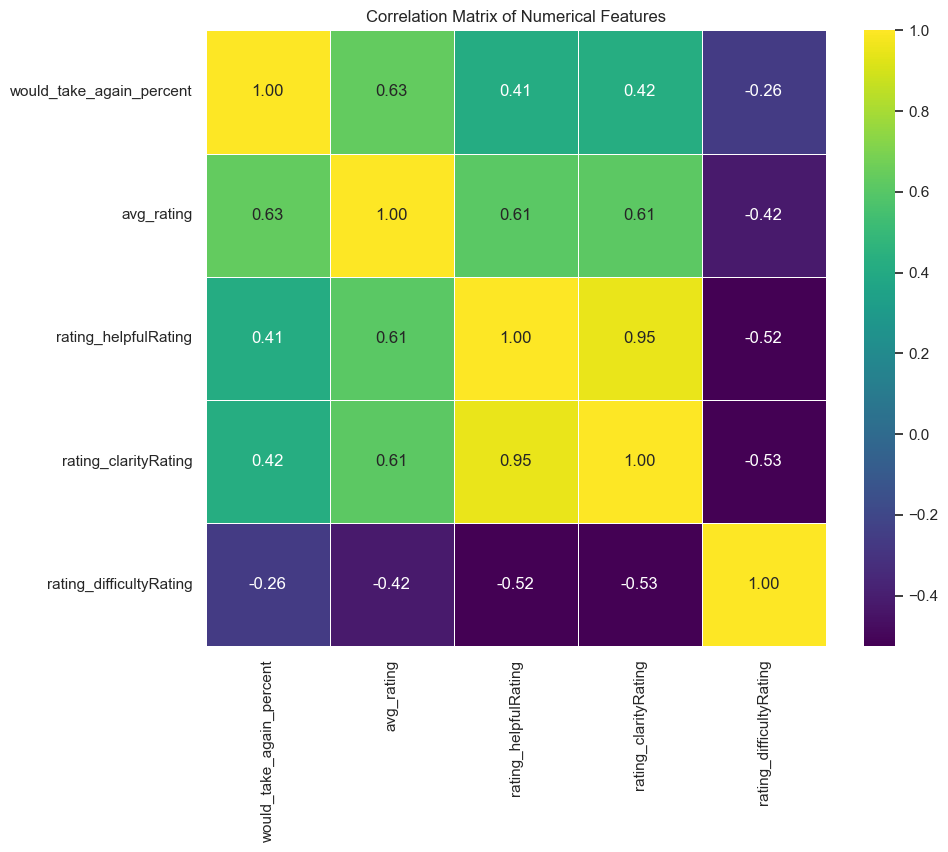

6210

In [21]:
# Compute correlation matrix
corr_matrix = df[numerical_cols].corr()

# Visualize the correlation matrix using Heatmap with seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=.5)
plt.title('Correlation Matrix of Numerical Features')
plt.show()

# Delete variables to clear memory and collect garbage
del corr_matrix
gc.collect()

<a id='group-comparisons-disciplines-and-ratings'></a>
### C. Group Comparisons (Disciplines and Ratings)

Average ratings are compared across different disciplines and sub-disciplines using bar plots and treemaps.  This allows for visualizing rating trends based on subject area.

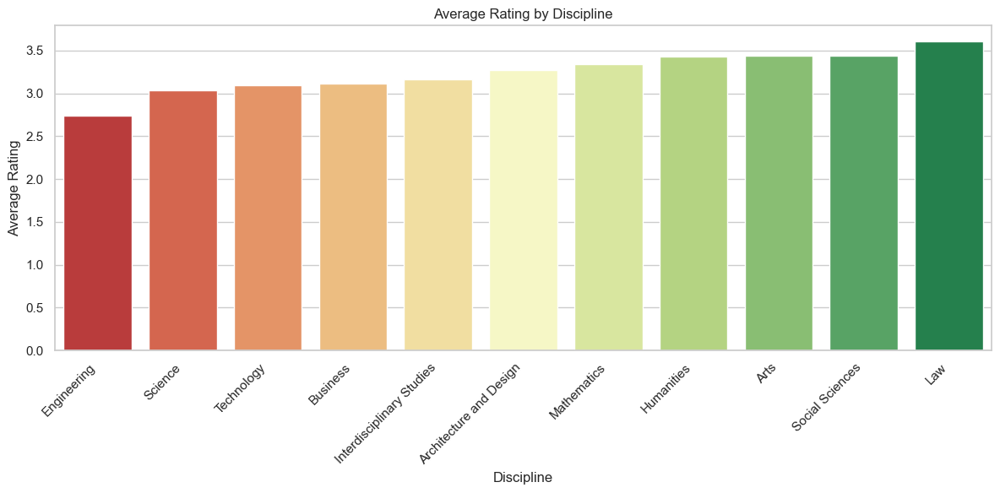

5398

In [22]:
# Average ratings by discipline
discipline_ratings = df.groupby('discipline')['avg_rating'].mean().reset_index()

# Sort the DataFrame in ascending order by avg_rating
discipline_ratings = discipline_ratings.sort_values(by='avg_rating', ascending=True)

# Plot average ratings across disciplines using seaborn
plt.figure(figsize=(12, 6))
sns.barplot(x='discipline', y='avg_rating', data=discipline_ratings, palette='RdYlGn')
plt.title('Average Rating by Discipline')
plt.xlabel('Discipline')
plt.ylabel('Average Rating')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Group by discipline and sub-discipline to calculate mean average ratings
grouped_ratings = df.groupby(['discipline', 'sub_discipline'])['avg_rating'].mean().reset_index()

# Create Treemap using Plotly
fig = px.treemap(
    grouped_ratings,
    path=['discipline', 'sub_discipline'],
    values='avg_rating',
    color='avg_rating',
    color_continuous_scale='RdYlGn',
    title='Average Rating by Discipline and Sub-Discipline',
    labels={'avg_rating': 'Average Rating'}
)

# Customize the treemap to display avg_rating on each sub-discipline
fig.update_traces(
    texttemplate='%{label}<br> %{value:.2f}',
    textposition='middle center',
    textfont=dict(
        size=12,
        color='black'
    )
)

# Further Customize Layout
fig.update_layout(
    width=1550,
    height=1000,
    title={
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=100, l=25, r=25, b=25)  # Adjust margins if necessary
)

# Display the figure
fig.show()

# Delete variables to clear memory and collect garbage
del discipline_ratings, grouped_ratings, fig
gc.collect()

<a id='hypothesis-testing-gender-and-ratings'></a>
### D. Hypothesis Testing (Gender and Ratings)

An independent samples t-test is performed to determine if there's a statistically significant difference in average ratings between male and female professors.

In [23]:
# Gender Bias in Average Ratings
male_ratings = df[df['gender'] == 'Male']['avg_rating']
female_ratings = df[df['gender'] == 'Female']['avg_rating']

# Perform independent t-test
t_stat, p_val = ttest_ind(male_ratings, female_ratings, nan_policy='omit', equal_var=False)
print("T-Test Results for Gender Bias in Average Ratings:")
print(f"T-Statistic: {t_stat:.4f}, P-Value: {p_val:.4f}")
if p_val < 0.05:
    print("Result: Statistically significant difference in average ratings between genders.")
else:
    print("Result: No statistically significant difference in average ratings between genders.")


    # Delete variables to clear memory and collect garbage
    del male_ratings, female_ratings, t_stat, p_val
    gc.collect()

T-Test Results for Gender Bias in Average Ratings:
T-Statistic: 65.3227, P-Value: 0.0000
Result: Statistically significant difference in average ratings between genders.


<a id='two-way-anova-gender-discipline-and-ratings'></a>
### E. Two-Way ANOVA (Gender, Discipline, and Ratings)

A two-way ANOVA is conducted to analyze the main and interaction effects of gender and discipline on average professor ratings.

In [24]:
# Two-Way ANOVA
model = ols('avg_rating ~ C(gender) + C(discipline) + C(gender):C(discipline)', data=df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)

print("Two-Way ANOVA Table:")
display(anova_table)

# Interpretation of interaction effect
if anova_table.loc['C(gender):C(discipline)', 'PR(>F)'] < 0.05:
    print("Result: Statistically significant interaction between gender and discipline.")
else:
    print("Result: No statistically significant interaction between gender and discipline.")


    # Delete variables to clear memory and collect garbage
    del model, anova_table

    gc.collect()

Two-Way ANOVA Table:


,sum_sq,df,F,PR(>F)
C(gender),8.034855e+03,1.0,8559.425506,0.0
C(discipline),5.336212e+04,10.0,5684.596967,0.0
C(gender):C(discipline),3.447889e+03,10.0,367.299045,0.0
Residual,1.401163e+06,1492641.0,NaN,NaN


Result: Statistically significant interaction between gender and discipline.


<a id='departmental-bias-analysis'></a>
### F. Departmental Bias Analysis

The distribution of ratings across disciplines is visualized using box plots and heatmaps.  This helps to assess if certain disciplines consistently receive higher or lower ratings, which could indicate departmental bias.

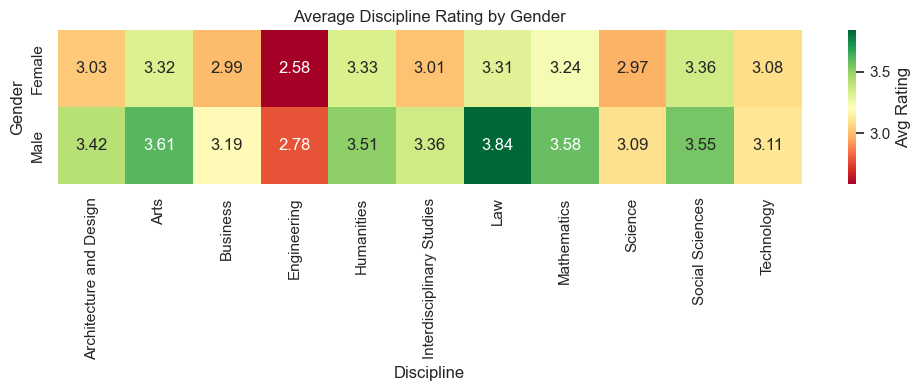

6659

In [25]:
# Plot distribution of average ratings by discipline using Plotly
fig = px.box(
    df, 
    x='discipline', 
    y='avg_rating',
    title='Distribution of Average Ratings by Discipline',
    labels={'avg_rating': 'Average Rating', 'discipline': 'Discipline'},
    color='discipline'
)
fig.update_layout(xaxis_tickangle=-45, width=900, height=600)
fig.show()

# Heatmap of average ratings by gender and discipline
grouped_ratings = df.groupby(['gender', 'discipline'])['avg_rating'].mean().reset_index()
grouped_ratings['avg_rating'] = grouped_ratings['avg_rating'].round(2)

# Pivot the data for heatmap
heatmap_data = grouped_ratings.pivot(index='gender', columns='discipline', values='avg_rating').fillna(0)

# Create Heatmap using seaborn
plt.figure(figsize=(12, 2))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", cmap='RdYlGn', cbar_kws={'label': 'Avg Rating'})
plt.title('Average Discipline Rating by Gender')
plt.xlabel('Discipline')
plt.ylabel('Gender')
plt.show()

# Delete variables to clear memory and collect garbage
del grouped_ratings, heatmap_data, fig

gc.collect()

<a id='tukeys-hsd-test-for-post-hoc-analysis'></a>
### G. Tukey's HSD Test for Post-Hoc Analysis

Tukey's HSD (Honestly Significant Difference) post-hoc test is performed following the ANOVA to make pairwise comparisons of average ratings between different gender-discipline combinations, and gender-subdiscipline combinations. This helps determine which specific groups differ significantly after finding an overall significant difference in ANOVA.

In [26]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
#%pip install ace-tools-open
import ace_tools_open as tools


# Filter data to include only relevant columns and drop missing values
tukey_data = df[['avg_rating', 'gender', 'discipline', 'sub_discipline']].dropna()

# Create a combined column for gender-discipline interaction
tukey_data['gender_discipline'] = tukey_data['gender'] + ' - ' + tukey_data['discipline']
tukey_data['gender_sub_discipline'] = tukey_data['gender'] + ' - ' + tukey_data['sub_discipline']

# Perform Tukey's HSD test for gender-discipline interaction
tukey_gender_discipline = pairwise_tukeyhsd(tukey_data['avg_rating'], tukey_data['gender_discipline'])

# Perform Tukey's HSD test for gender-sub_discipline interaction
tukey_gender_sub_discipline = pairwise_tukeyhsd(tukey_data['avg_rating'], tukey_data['gender_sub_discipline'])

# Filter results to include only comparisons within the same discipline for gender-discipline
filtered_discipline = [comp for comp in tukey_gender_discipline.summary().data[1:] 
                       if comp[0].split(' - ')[1] == comp[1].split(' - ')[1]]

# Filter results to include only comparisons within the same discipline for gender-sub_discipline
filtered_sub_discipline = [comp for comp in tukey_gender_sub_discipline.summary().data[1:] 
                           if comp[0].split(' - ')[1] == comp[1].split(' - ')[1]]

# Convert to DataFrames for easier visualization
tukey_discipline_df = pd.DataFrame(filtered_discipline, columns=tukey_gender_discipline.summary().data[0])
tukey_sub_discipline_df = pd.DataFrame(filtered_sub_discipline, columns=tukey_gender_sub_discipline.summary().data[0])

In [27]:
# Display the filtered results for gender-discipline and gender-sub_discipline interactions
tools.display_dataframe_to_user(name="Tukey HSD for Gender-Discipline Interaction", dataframe=tukey_discipline_df)

Tukey HSD for Gender-Discipline Interaction


In [28]:
tools.display_dataframe_to_user(name="Tukey HSD for Gender-Sub_discipline Interaction", dataframe=tukey_sub_discipline_df)

Tukey HSD for Gender-Sub_discipline Interaction


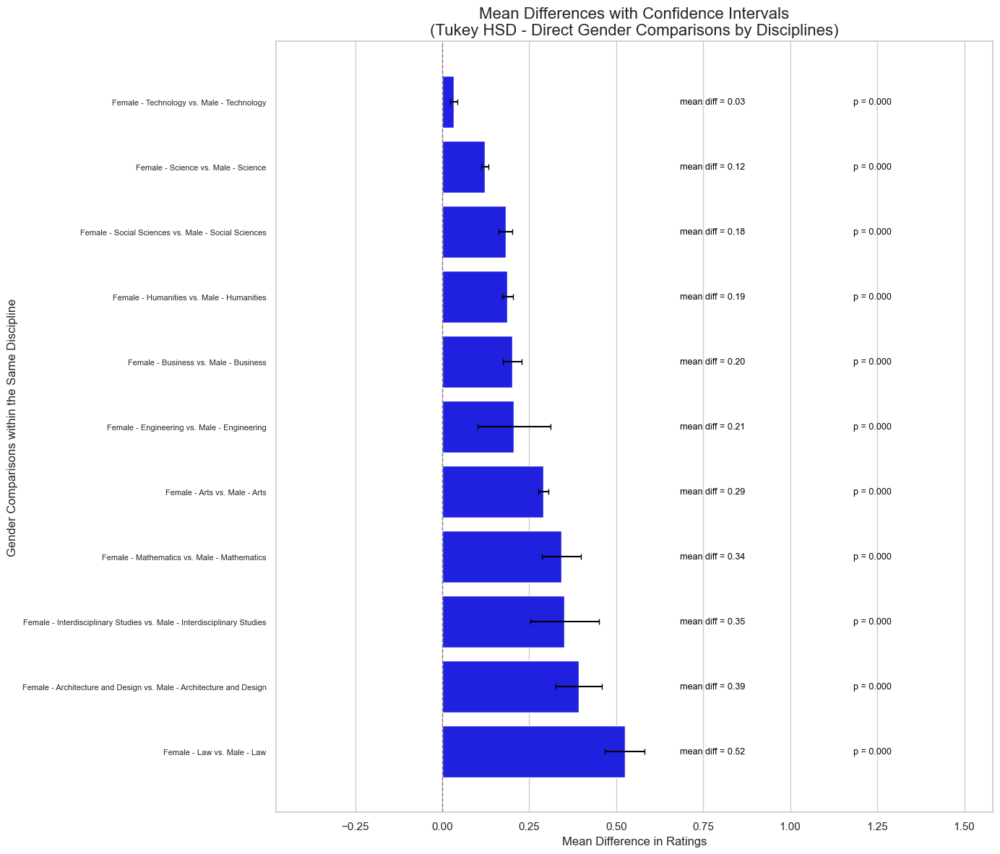

20

In [29]:
tukey_discipline_df_sorted = tukey_discipline_df.sort_values('meandiff')

# Create the plot
# Ensure the DataFrame has the correct column for y-axis
tukey_discipline_df_sorted['comparison'] = tukey_discipline_df_sorted['group1'] + ' vs. ' + tukey_discipline_df_sorted['group2']

plt.figure(figsize=(14, 12))
sns.set_style("whitegrid")

# Create the main bar plot
ax = sns.barplot(x='meandiff', y='comparison', data=tukey_discipline_df_sorted, 
                 palette=['red' if x < 0 else 'blue' for x in tukey_discipline_df_sorted['meandiff']])

# Add error bars
ax.errorbar(x=tukey_discipline_df_sorted['meandiff'], y=range(len(tukey_discipline_df_sorted)),
            xerr=[tukey_discipline_df_sorted['meandiff'] - tukey_discipline_df_sorted['lower'], 
                  tukey_discipline_df_sorted['upper'] - tukey_discipline_df_sorted['meandiff']],
            fmt='none', ecolor='black', capsize=3)

# Customize the plot
plt.axvline(x=0, color='gray', linestyle='--', linewidth=1)
plt.title('Mean Differences with Confidence Intervals\n(Tukey HSD - Direct Gender Comparisons by Disciplines)', fontsize=16)
plt.xlabel('Mean Difference in Ratings', fontsize=12)
plt.ylabel('Gender Comparisons within the Same Discipline', fontsize=12)

# Improve readability of y-axis labels
plt.yticks(fontsize=8)

# Add labels to the right of each bar
for i, (v, p_val) in enumerate(zip(tukey_discipline_df_sorted['meandiff'], tukey_discipline_df_sorted['p-adj'])):
    # Add p-value annotation
    ax.text(max(tukey_discipline_df_sorted['upper']) + 0.6, i, f'p = {p_val:.3f}', 
            va='center', fontsize=9, ha='left', color='black')
    # Add mean difference labels
    ax.text(max(tukey_discipline_df_sorted['upper']) + 0.1, i, f'mean diff = {v:.2f} ', 
            va='center', fontsize=9, ha='left', color='black')

# Adjust x-axis to make room for labels
plt.xlim(min(tukey_discipline_df_sorted['lower']) - 0.5, max(tukey_discipline_df_sorted['upper']) + 1)

# Adjust layout and display
plt.tight_layout()
plt.show()

# Delete variables to clear memory and collect garbage
del tukey_discipline_df_sorted

gc.collect()

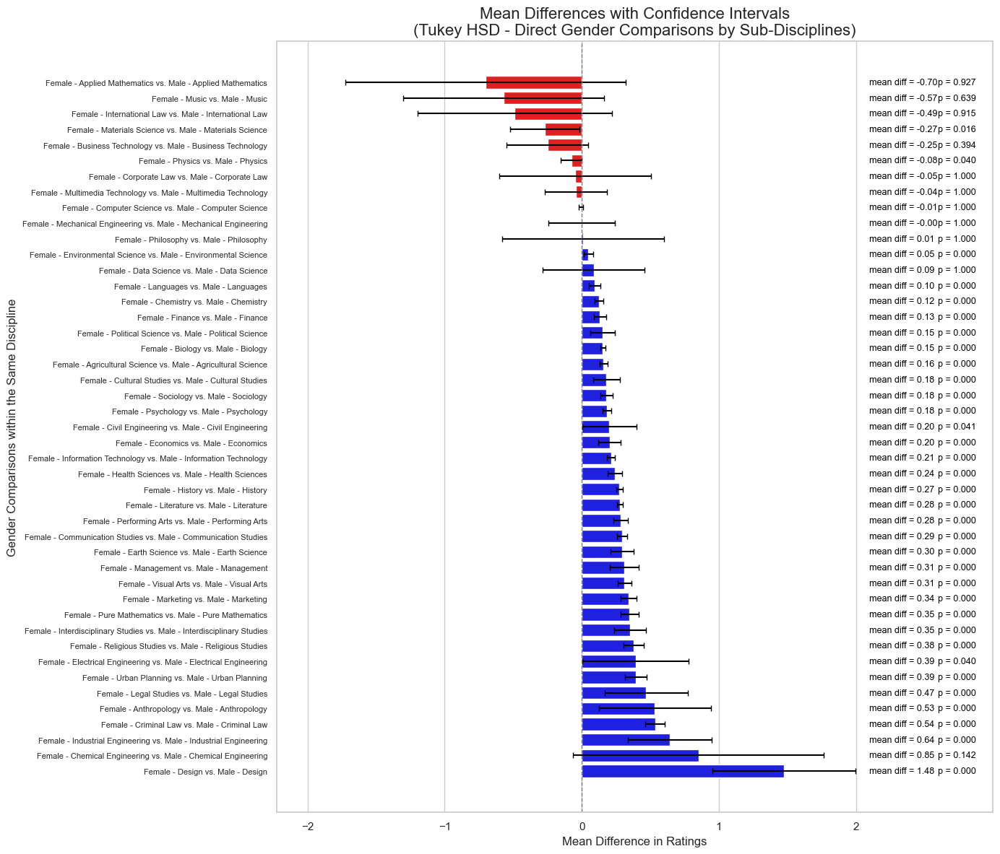

6206

In [30]:
tukey_sub_discipline_df_sorted = tukey_sub_discipline_df.sort_values('meandiff')

# Create the plot
# Ensure the DataFrame has the correct column for y-axis
tukey_sub_discipline_df_sorted['comparison'] = tukey_sub_discipline_df_sorted['group1'] + ' vs. ' + tukey_sub_discipline_df_sorted['group2']

plt.figure(figsize=(14, 12))
sns.set_style("whitegrid")

# Create the main bar plot
ax = sns.barplot(x='meandiff', y='comparison', data=tukey_sub_discipline_df_sorted, 
                 palette=['red' if x < 0 else 'blue' for x in tukey_sub_discipline_df_sorted['meandiff']])

# Add error bars
ax.errorbar(x=tukey_sub_discipline_df_sorted['meandiff'], y=range(len(tukey_sub_discipline_df_sorted)),
            xerr=[tukey_sub_discipline_df_sorted['meandiff'] - tukey_sub_discipline_df_sorted['lower'], 
                  tukey_sub_discipline_df_sorted['upper'] - tukey_sub_discipline_df_sorted['meandiff']],
            fmt='none', ecolor='black', capsize=3)

# Customize the plot
plt.axvline(x=0, color='gray', linestyle='--', linewidth=1)
plt.title('Mean Differences with Confidence Intervals\n(Tukey HSD - Direct Gender Comparisons by Sub-Disciplines)', fontsize=16)
plt.xlabel('Mean Difference in Ratings', fontsize=12)
plt.ylabel('Gender Comparisons within the Same Discipline', fontsize=12)

# Improve readability of y-axis labels
plt.yticks(fontsize=8)

# Add labels to the right of each bar
for i, (v, p_val) in enumerate(zip(tukey_sub_discipline_df_sorted['meandiff'], tukey_sub_discipline_df_sorted['p-adj'])):
    # Add p-value annotation
    ax.text(max(tukey_sub_discipline_df_sorted['upper']) + 0.6, i, f'p = {p_val:.3f}', 
            va='center', fontsize=9, ha='left', color='black')
    # Add mean difference labels
    ax.text(max(tukey_sub_discipline_df_sorted['upper']) + 0.1, i, f'mean diff = {v:.2f} ', 
            va='center', fontsize=9, ha='left', color='black')

# Adjust x-axis to make room for labels
plt.xlim(min(tukey_sub_discipline_df_sorted['lower']) - 0.5, max(tukey_sub_discipline_df_sorted['upper']) + 1)

# Adjust layout and display
plt.tight_layout()
plt.show()

# Delete variables to clear memory and collect garbage
del tukey_sub_discipline_df_sorted

gc.collect()

<a id='in-depth-sentiment-analysis'></a>
# 7. In-Depth Sentiment Analysis

This section performs sentiment analysis using multiple methods to understand the emotional tone expressed in student comments about professors.

<a id='sentiment-analysis-using-unigrams-and-bigrams'></a>
### A. Sentiment Analysis Using Unigrams and Bigrams

The most frequent individual words (unigrams) and two-word sequences (bigrams) are identified and visualized. This provides a basic understanding of the common terms used in reviews.

In [31]:
def read_chunks(file_path, chunk_size=50000):
    return pd.read_csv(file_path, chunksize=chunk_size)

# Define Helper Functions
def convert_to_list(s):
    try:
        return ast.literal_eval(s)
    except (ValueError, SyntaxError):
        return []

Preparing data for visualization...


Top unigrams and bigrams saved to CSV files.


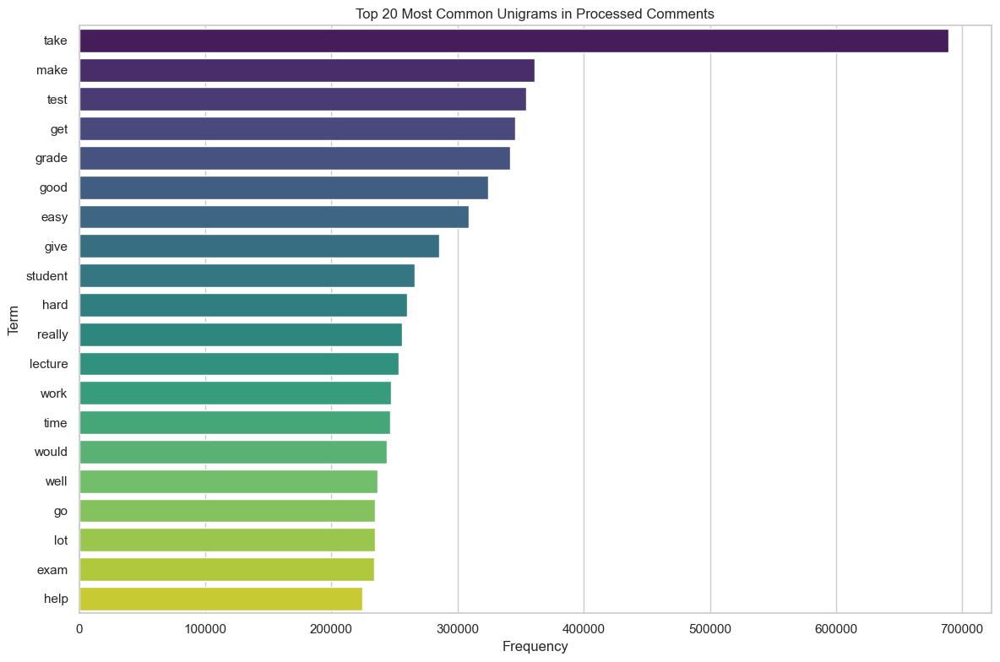

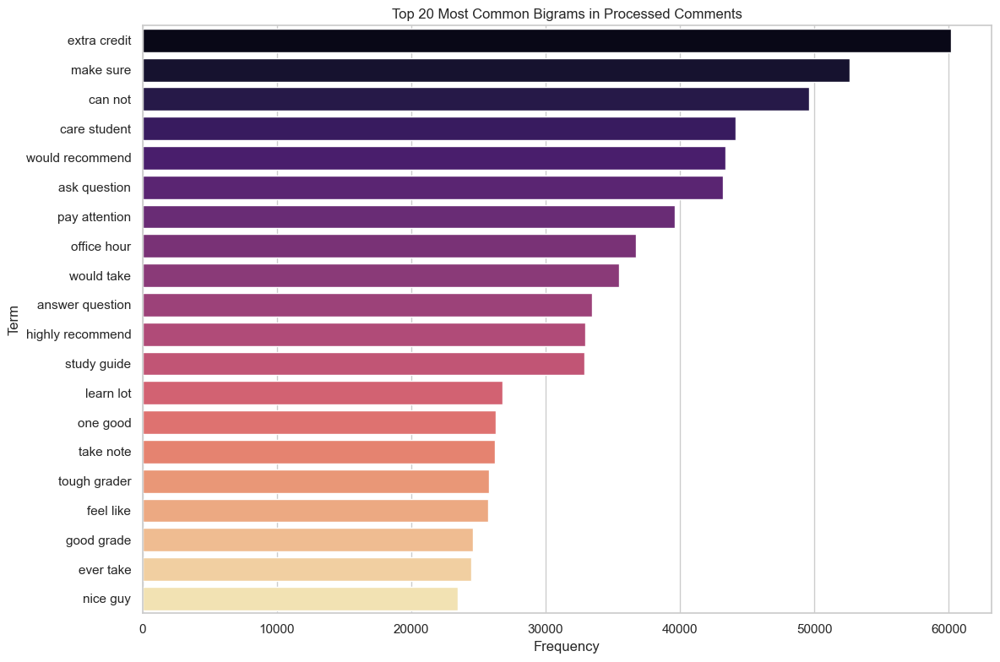

352

In [32]:
def flatten_tokens(comments):
    for tokens in comments:
        for token in tokens:
            yield token

def generate_bigrams(tokens):
    return list(ngrams(tokens, 2))

# Initialize Counters
unigram_counter = Counter()
bigram_counter = Counter()

# Define the path to your CSV file
processed_comments = df['processed_comment'].apply(lambda x: x if isinstance(x, list) else convert_to_list(x))

# Update Unigram and Bigram Counts
for tokens in processed_comments:
    unigram_counter.update(tokens)
    bigram_counter.update(generate_bigrams(tokens))

# Add bigrams to the DataFrame
df['bigrams'] = processed_comments.apply(generate_bigrams)

# Prepare Data for Visualization
print("Preparing data for visualization...")

# Top 20 Unigrams
unigram_df = pd.DataFrame(unigram_counter.most_common(20), columns=['Term', 'Frequency'])

# Top 20 Bigrams
bigram_df = pd.DataFrame(bigram_counter.most_common(20), columns=['Term', 'Frequency'])
bigram_df['Term'] = bigram_df['Term'].apply(lambda x: ' '.join(x))  # Convert tuple to string

#unigram_df.to_csv('top_20_unigrams.csv', index=False)
#bigram_df.to_csv('top_20_bigrams.csv', index=False)

print("Top unigrams and bigrams saved to CSV files.")

unigram_df = pd.read_csv("top_20_unigrams.csv")
bigram_df = pd.read_csv("top_20_bigrams.csv")

# Plot Top 20 Unigrams
plt.figure(figsize=(12, 8))
sns.barplot(x='Frequency', y='Term', data=unigram_df, palette='viridis')
plt.title('Top 20 Most Common Unigrams in Processed Comments')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.tight_layout()
plt.show()

# Plot Top 20 Bigrams
plt.figure(figsize=(12, 8))
sns.barplot(x='Frequency', y='Term', data=bigram_df, palette='magma')
plt.title('Top 20 Most Common Bigrams in Processed Comments')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.tight_layout()
plt.show()

# Clear variables to free up memory
del unigram_counter, bigram_counter, processed_comments, unigram_df, bigram_df

# Collect garbage
gc.collect()

<a id='sentiment-analysis-using-opinion-lexicon'></a>
### B. Sentiment Analysis Using Opinion Lexicon

NLTK's opinion lexicon is used to classify words in the comments as positive or negative.  Frequencies of the top positive and negative words are visualized.

Top positive and negative terms saved to CSV files.


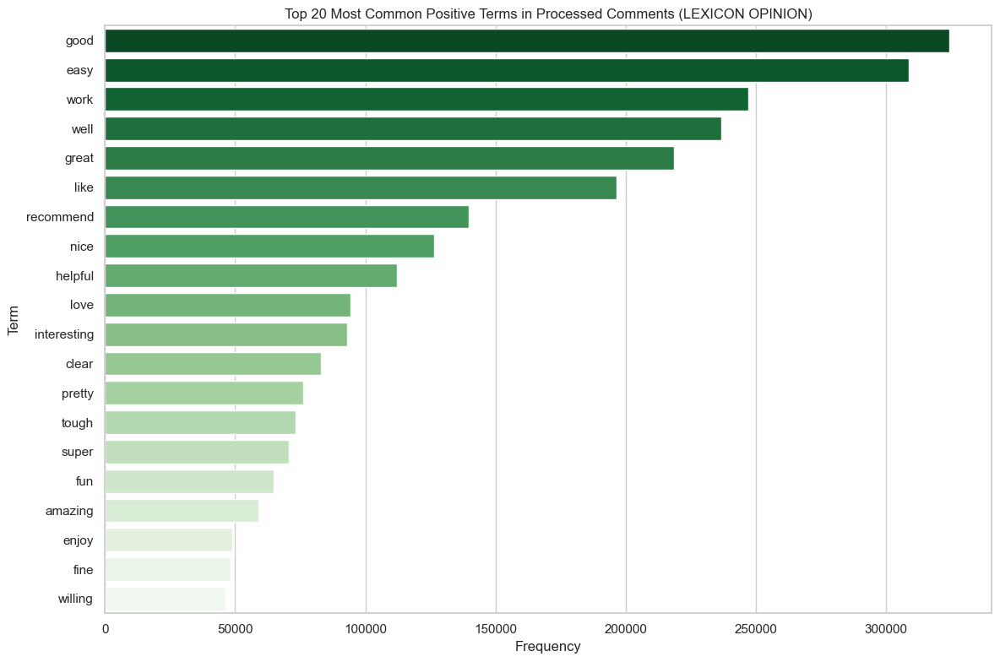

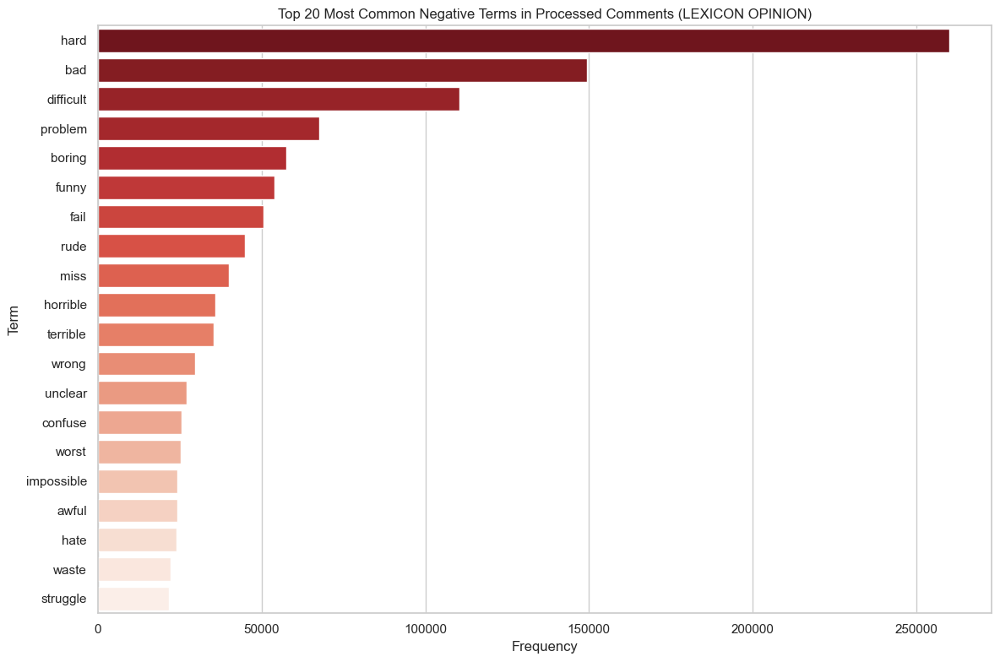

361

In [33]:
#Import NLTK's Opinion Lexicon
from nltk.corpus import opinion_lexicon
import gc

# Define positive and negative words
positive_words = set(opinion_lexicon.positive())
negative_words = set(opinion_lexicon.negative())

processed_comments = df['processed_comment'].apply(lambda x: x if isinstance(x, list) else convert_to_list(x))

# Function to extract positive and negative terms from tokens
def extract_opinion_terms(tokens):
    pos_terms = [word for word in tokens if word in positive_words]
    neg_terms = [word for word in tokens if word in negative_words]
    return pos_terms, neg_terms

# Apply the function to extract positive and negative terms
df[['positive_terms_lexicon', 'negative_terms_lexicon']] = processed_comments.apply(
    lambda x: pd.Series(extract_opinion_terms(x))
)

# Initialize Counters for positive and negative terms
positive_counter = Counter()
negative_counter = Counter()

# Update Counters with progress bar
for sublist in df['positive_terms_lexicon']:
    positive_counter.update([term for term in sublist if pd.notnull(term)])

for sublist in df['negative_terms_lexicon']:
    negative_counter.update([term for term in sublist if pd.notnull(term)])

# Create DataFrames for the top 20 positive and negative terms
positive_df = pd.DataFrame(positive_counter.most_common(20), columns=['Term', 'Frequency'])
negative_df = pd.DataFrame(negative_counter.most_common(20), columns=['Term', 'Frequency'])

#df.to_csv("RMP SET.csv", index=False)

# Optional: Save Results to CSV
#positive_df.to_csv('lexicon_top_20_positive_terms.csv', index=False)
#negative_df.to_csv('lexicon_top_20_negative_terms.csv', index=False)

print("Top positive and negative terms saved to CSV files.")

positive_df = pd.read_csv("lexicon_top_20_positive_terms.csv")
negative_df = pd.read_csv("lexicon_top_20_negative_terms.csv")

# Plot the top 20 positive terms
plt.figure(figsize=(12, 8))
sns.barplot(x='Frequency', y='Term', data=positive_df, palette='Greens_r')
plt.title('Top 20 Most Common Positive Terms in Processed Comments (LEXICON OPINION)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.tight_layout()
plt.show()

# Plot the top 20 negative terms
plt.figure(figsize=(12, 8))
sns.barplot(x='Frequency', y='Term', data=negative_df, palette='Reds_r')
plt.title('Top 20 Most Common Negative Terms in Processed Comments (LEXICON OPINION)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.tight_layout()
plt.show()


# Delete variables to clear memory and collect garbage
del positive_df
del negative_df
del positive_counter
del negative_counter

gc.collect()

<a id='sentiment-analysis-using-vader'></a>
### C. Sentiment Analysis Using VADER

VADER (Valence Aware Dictionary and sEntiment Reasoner) sentiment analysis is performed to assign sentiment scores to each comment, and top positive/negative terms are identified.

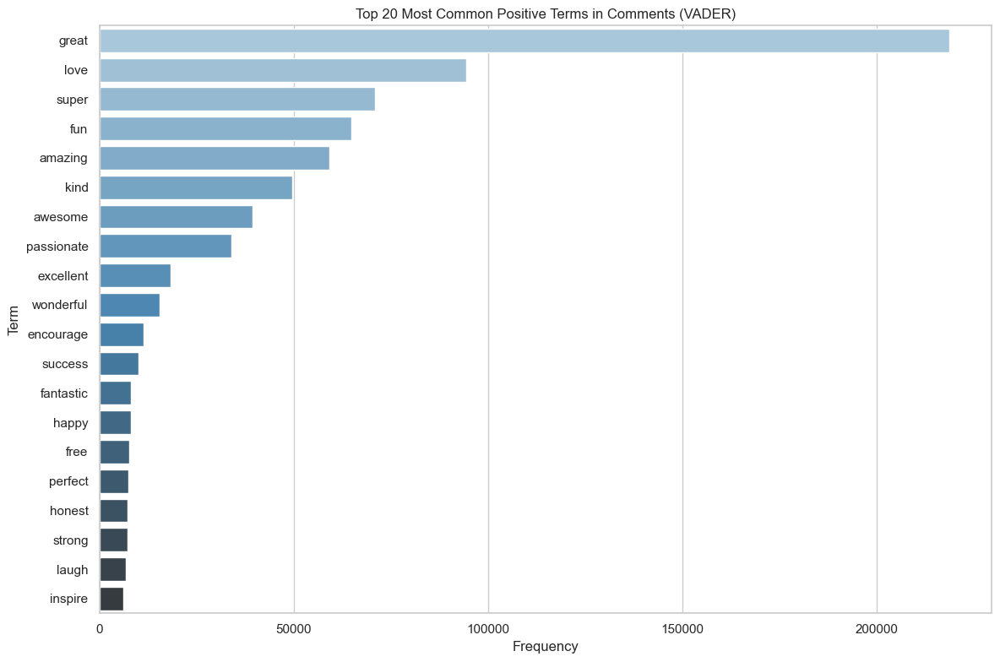

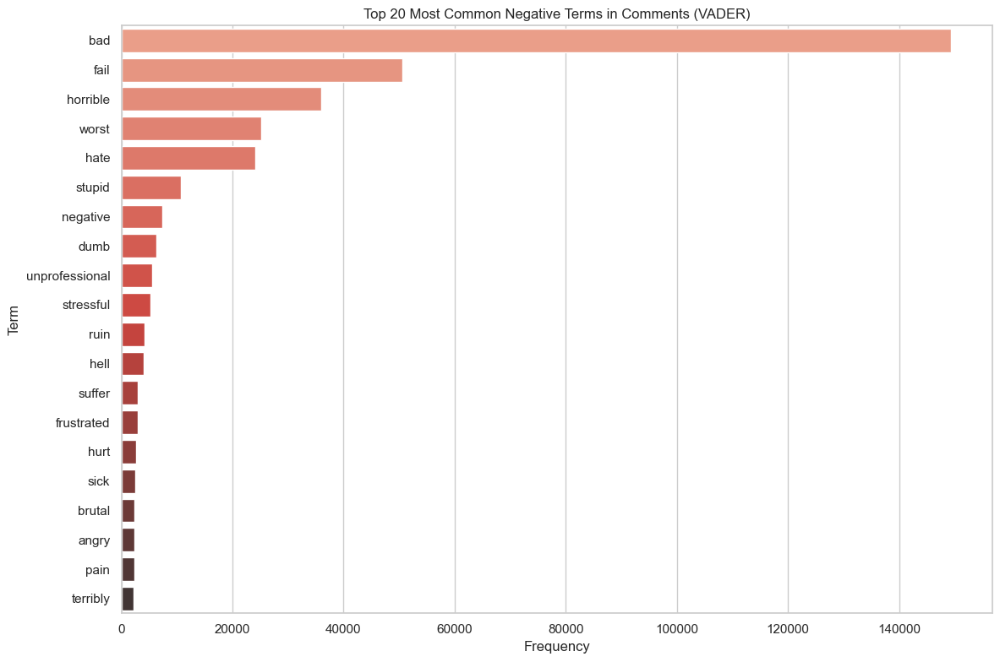

VADER sentiment terms saved to CSV files.


355

In [34]:
# Import VADER sentiment analyzer
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Initialize VADER sentiment analyzer
sia = SentimentIntensityAnalyzer()

# Define preprocessing function
def preprocess_text(text):
    if isinstance(text, list):
        text = ' '.join(text)
    return text.split()

# Apply preprocessing
processed_comments = processed_comments.apply(preprocess_text)

# Function to extract negative and positive terms based on VADER scores
def extract_sentiment_terms(text):
    tokens = preprocess_text(text)
    negative_words = [word for word in tokens if sia.polarity_scores(word)['compound'] <= -0.5]
    positive_words = [word for word in tokens if sia.polarity_scores(word)['compound'] >= 0.5]
    return pd.Series([positive_words, negative_words])

# Apply the function with a progress bar
df[['positive_terms_vader', 'negative_terms_vader']] = processed_comments.apply(extract_sentiment_terms)

#Initialize Counters for VADER positive and negative terms
vader_positive_counter = Counter()
vader_negative_counter = Counter()

# Update Counters
vader_positive_counter.update([term for sublist in df['positive_terms_vader'] for term in sublist if pd.notnull(term)])
vader_negative_counter.update([term for sublist in df['negative_terms_vader'] for term in sublist if pd.notnull(term)])

#df.to_csv("RMP SET.csv", index=False)

# Create DataFrames for the top 20 positive and negative VADER terms
vader_positive_df = pd.DataFrame(vader_positive_counter.most_common(20), columns=['Term', 'Frequency'])
vader_negative_df = pd.DataFrame(vader_negative_counter.most_common(20), columns=['Term', 'Frequency'])

# Plot the top 20 VADER positive terms
plt.figure(figsize=(12, 8))
sns.barplot(x='Frequency', y='Term', data=vader_positive_df, palette='Blues_d')
plt.title('Top 20 Most Common Positive Terms in Comments (VADER)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.tight_layout()
plt.show()

# Plot the top 20 VADER negative terms
plt.figure(figsize=(12, 8))
sns.barplot(x='Frequency', y='Term', data=vader_negative_df, palette='Reds_d')
plt.title('Top 20 Most Common Negative Terms in Comments (VADER)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.tight_layout()
plt.show()

# Optional: Save VADER sentiment terms to CSV
#vader_positive_df.to_csv('vader_top_20_positive_terms.csv', index=False)
#vader_negative_df.to_csv('vader_top_20_negative_terms.csv', index=False)

print("VADER sentiment terms saved to CSV files.")

# Delete variables to clear memory and collect garbage
del vader_positive_df
del vader_negative_df
del vader_positive_counter
del vader_negative_counter
del processed_comments

gc.collect()

<a id='generating-word-clouds-for-sentiment-terms'></a>
### D. Generating Word Clouds for Sentiment Terms

Word clouds are generated to visually represent the most frequent positive and negative terms based on both lexicon-based and VADER sentiment analyses.

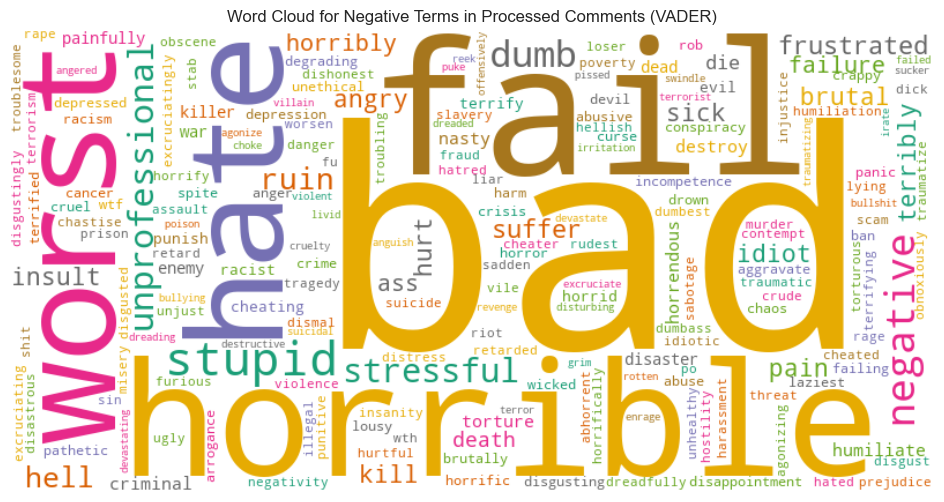

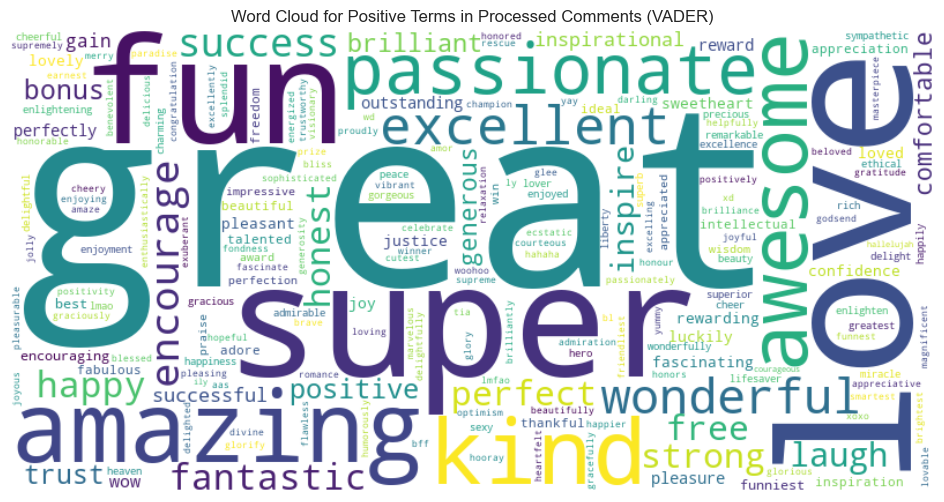

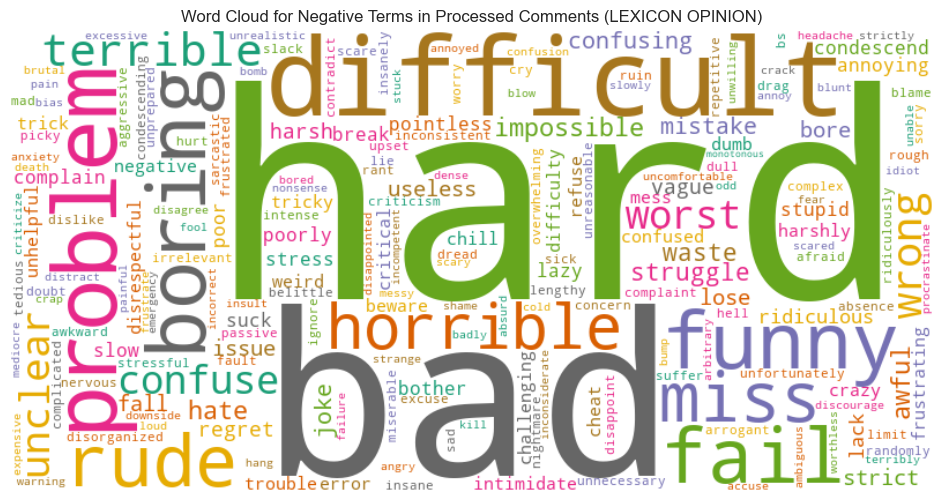

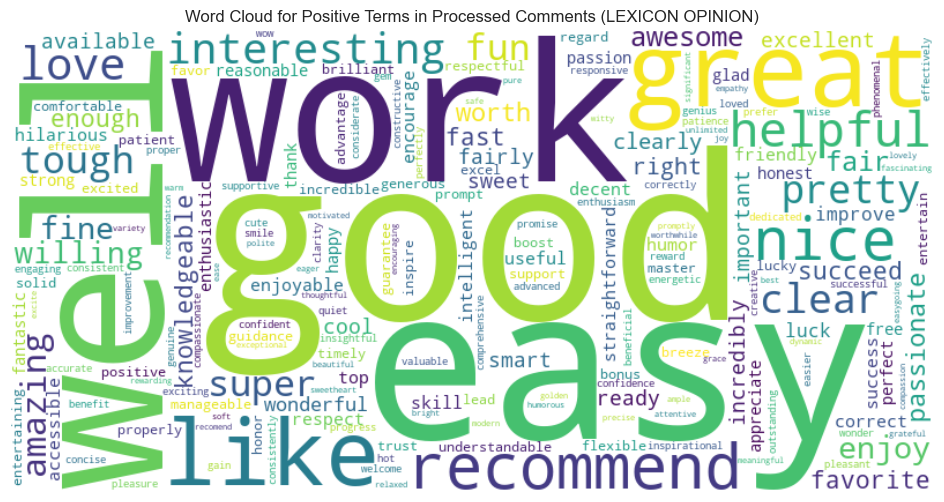

21977

In [35]:
negative_terms_vader = df['negative_terms_vader'].apply(lambda x: x if isinstance(x, list) else convert_to_list(x))
positive_terms_vader = df['positive_terms_vader'].apply(lambda x: x if isinstance(x, list) else convert_to_list(x))

negative_terms_lexicon = df['negative_terms_lexicon'].apply(lambda x: x if isinstance(x, list) else convert_to_list(x))
positive_terms_lexicon = df['positive_terms_lexicon'].apply(lambda x: x if isinstance(x, list) else convert_to_list(x))



# Create a frequency dictionary for negative terms (VADER)
neg_term_freq_vader = Counter([term for sublist in negative_terms_vader for term in sublist if pd.notnull(term)])

# Generate word cloud for negative terms based on frequency
wordcloud_neg_vader = WordCloud(width=800, height=400, colormap = 'Dark2', background_color='white').generate_from_frequencies(neg_term_freq_vader)

# Plot the word cloud for negative terms (VADER)
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud_neg_vader, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Negative Terms in Processed Comments (VADER)')
plt.show()

# Create a frequency dictionary for positive terms (VADER)
pos_term_freq_vader = Counter([term for sublist in positive_terms_vader for term in sublist if pd.notnull(term)])

# Generate word cloud for positive terms based on frequency
wordcloud_pos_vader = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(pos_term_freq_vader)

# Plot the word cloud for positive terms (VADER)
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud_pos_vader, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Positive Terms in Processed Comments (VADER)')
plt.show()


# Create a frequency dictionary for negative terms (LEXICON)
neg_term_freq_lexicon = Counter([term for sublist in negative_terms_lexicon for term in sublist if pd.notnull(term)])

# Generate word cloud for negative terms based on frequency
wordcloud_neg_lexicon = WordCloud(width=800, height=400, colormap = 'Dark2', background_color='white').generate_from_frequencies(neg_term_freq_lexicon)

# Plot the word cloud for negative terms (LEXICON)
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud_neg_lexicon, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Negative Terms in Processed Comments (LEXICON OPINION)')
plt.show()



# Create a frequency dictionary for positive terms (LEXICON)
pos_term_freq_lexicon = Counter([term for sublist in positive_terms_lexicon for term in sublist if pd.notnull(term)])

# Generate word cloud for positive terms based on frequency
wordcloud_pos_lexicon = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(pos_term_freq_lexicon)

# Plot the word cloud for positive terms (LEXICON)
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud_pos_lexicon, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Positive Terms in Processed Comments (LEXICON OPINION)')
plt.show()

# Delete variables to clear memory and collect garbage
del neg_term_freq_vader, wordcloud_neg_vader, pos_term_freq_vader, wordcloud_pos_vader
del neg_term_freq_lexicon, wordcloud_neg_lexicon, pos_term_freq_lexicon, wordcloud_pos_lexicon
gc.collect()

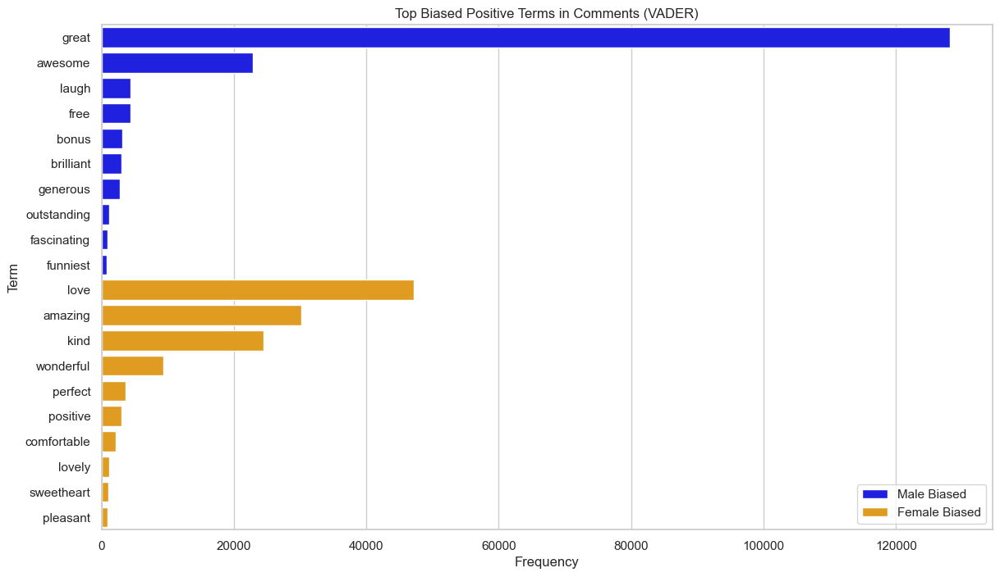

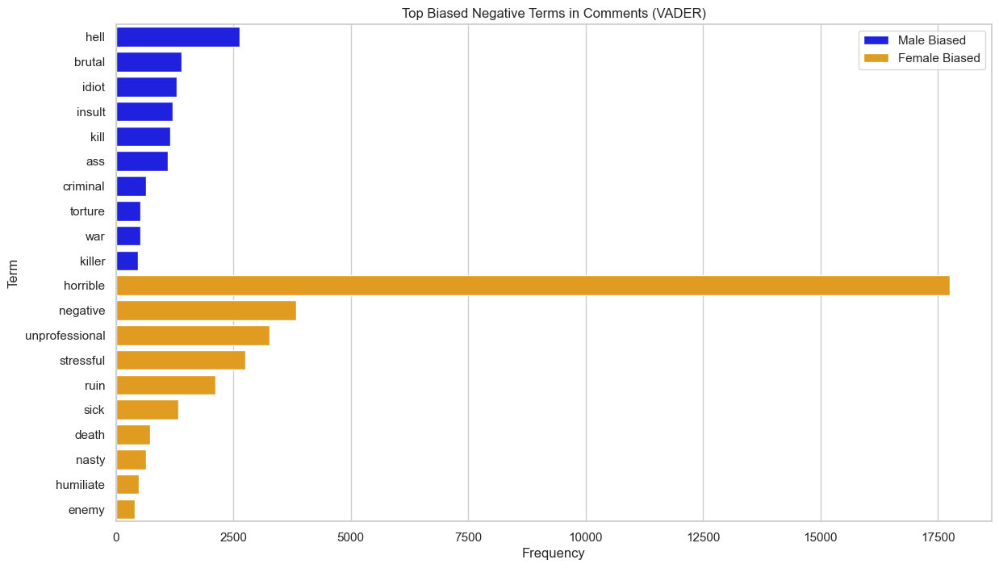

773

In [36]:
# Create separate dataframes for male and female genders
df_male = df[df['gender'] == 'Male']
df_female = df[df['gender'] == 'Female']

# Function to calculate term frequency
def calculate_term_frequency(df, term_column):
    all_terms = [term for terms in df[term_column] for term in terms]
    term_freq = Counter(all_terms)
    term_df = pd.DataFrame(term_freq.items(), columns=['Term', 'Frequency']).sort_values(by='Frequency', ascending=False)
    return term_df

# Calculate frequency of positive and negative terms for male and female genders
male_positive_terms_freq = calculate_term_frequency(df_male, 'positive_terms_vader')
male_negative_terms_freq = calculate_term_frequency(df_male, 'negative_terms_vader')
female_positive_terms_freq = calculate_term_frequency(df_female, 'positive_terms_vader')
female_negative_terms_freq = calculate_term_frequency(df_female, 'negative_terms_vader')

# Merge frequencies
positive_terms_merged = pd.merge(
    male_positive_terms_freq, 
    female_positive_terms_freq, 
    on='Term', 
    how='outer', 
    suffixes=('_Male', '_Female')
).fillna(0)

negative_terms_merged = pd.merge(
    male_negative_terms_freq, 
    female_negative_terms_freq, 
    on='Term', 
    how='outer', 
    suffixes=('_Male', '_Female')
).fillna(0)

# Calculate relative frequency
positive_terms_merged['Relative_Freq_Male'] = positive_terms_merged['Frequency_Male'] / positive_terms_merged['Frequency_Male'].sum()
positive_terms_merged['Relative_Freq_Female'] = positive_terms_merged['Frequency_Female'] / positive_terms_merged['Frequency_Female'].sum()

negative_terms_merged['Relative_Freq_Male'] = negative_terms_merged['Frequency_Male'] / negative_terms_merged['Frequency_Male'].sum()
negative_terms_merged['Relative_Freq_Female'] = negative_terms_merged['Frequency_Female'] / negative_terms_merged['Frequency_Female'].sum()

# Define a threshold for bias
bias_threshold = 1.1

# Identify biased positive terms
biased_positive_terms = positive_terms_merged[
    (positive_terms_merged['Relative_Freq_Male'] > bias_threshold * positive_terms_merged['Relative_Freq_Female']) |
    (positive_terms_merged['Relative_Freq_Female'] > bias_threshold * positive_terms_merged['Relative_Freq_Male'])
]

# Identify biased negative terms
biased_negative_terms = negative_terms_merged[
    (negative_terms_merged['Relative_Freq_Male'] > bias_threshold * negative_terms_merged['Relative_Freq_Female']) |
    (negative_terms_merged['Relative_Freq_Female'] > bias_threshold * negative_terms_merged['Relative_Freq_Male'])
]

# Determine bias direction
def determine_bias(row, male_col, female_col):
    if row[male_col] > row[female_col] * bias_threshold:
        return 'Male'
    elif row[female_col] > row[male_col] * bias_threshold:
        return 'Female'
    else:
        return 'Neutral'

biased_positive_terms['Bias'] = biased_positive_terms.apply(determine_bias, axis=1, args=('Relative_Freq_Male', 'Relative_Freq_Female'))
biased_negative_terms['Bias'] = biased_negative_terms.apply(determine_bias, axis=1, args=('Relative_Freq_Male', 'Relative_Freq_Female'))

# Plot top biased positive terms
plt.figure(figsize=(14,8))
sns.barplot(
    y='Term', 
    x='Frequency_Male', 
    data=biased_positive_terms[biased_positive_terms['Bias'] == 'Male'].sort_values(by='Frequency_Male', ascending=False).head(10),
    color='blue',
    label='Male Biased'
)
sns.barplot(
    y='Term', 
    x='Frequency_Female', 
    data=biased_positive_terms[biased_positive_terms['Bias'] == 'Female'].sort_values(by='Frequency_Female', ascending=False).head(10),
    color='orange',
    label='Female Biased'
)
plt.title('Top Biased Positive Terms in Comments (VADER)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.legend()
plt.show()

# Plot top biased negative terms
plt.figure(figsize=(14,8))
sns.barplot(
    y='Term', 
    x='Frequency_Male', 
    data=biased_negative_terms[biased_negative_terms['Bias'] == 'Male'].sort_values(by='Frequency_Male', ascending=False).head(10),
    color='blue',
    label='Male Biased'
)
sns.barplot(
    y='Term', 
    x='Frequency_Female', 
    data=biased_negative_terms[biased_negative_terms['Bias'] == 'Female'].sort_values(by='Frequency_Female', ascending=False).head(10),
    color='orange',
    label='Female Biased'
)
plt.title('Top Biased Negative Terms in Comments (VADER)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.legend()
plt.show()

# Delete variables to clear memory and collect garbage
del df_male, df_female, male_positive_terms_freq, male_negative_terms_freq, female_positive_terms_freq, female_negative_terms_freq
del positive_terms_merged, negative_terms_merged, biased_positive_terms, biased_negative_terms

gc.collect()

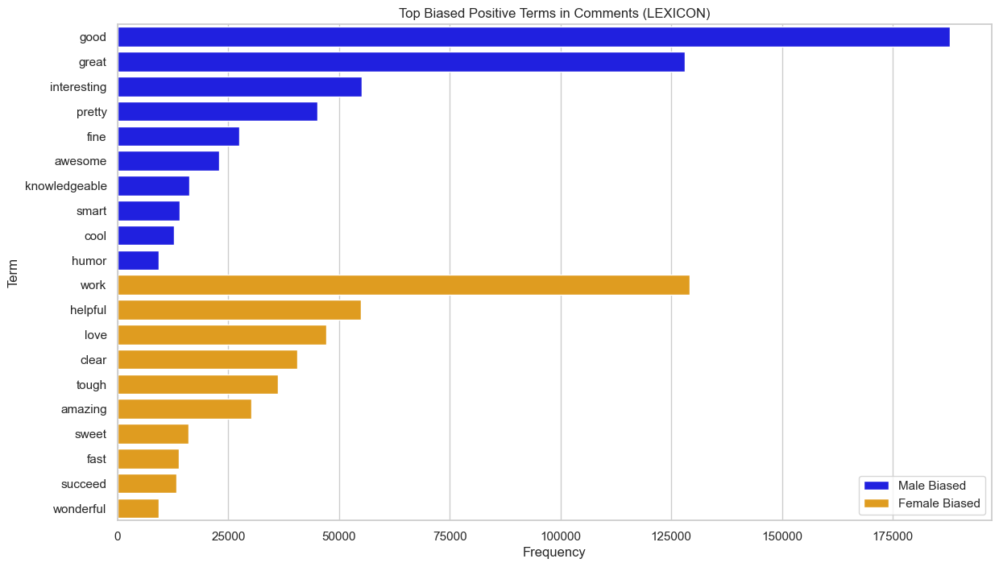

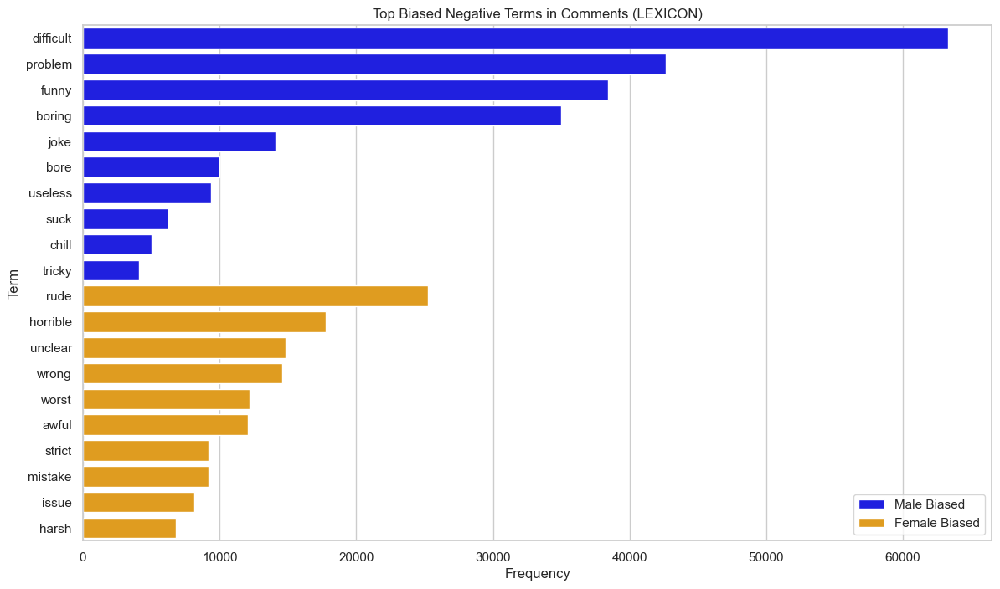

13560

In [37]:
# Create separate dataframes for male and female genders
df_male = df[df['gender'] == 'Male']
df_female = df[df['gender'] == 'Female']

# Function to calculate term frequency (already defined)
def calculate_term_frequency(df, term_column):
    all_terms = [term for terms in df[term_column] for term in terms]
    term_freq = Counter(all_terms)
    term_df = pd.DataFrame(term_freq.items(), columns=['Term', 'Frequency']).sort_values(by='Frequency', ascending=False)
    return term_df

# Calculate frequency of positive and negative terms for male and female genders (LEXICON)
male_positive_terms_freq_lexicon = calculate_term_frequency(df_male, 'positive_terms_lexicon')
male_negative_terms_freq_lexicon = calculate_term_frequency(df_male, 'negative_terms_lexicon')
female_positive_terms_freq_lexicon = calculate_term_frequency(df_female, 'positive_terms_lexicon')
female_negative_terms_freq_lexicon = calculate_term_frequency(df_female, 'negative_terms_lexicon')

# Merge frequencies (LEXICON)
positive_terms_merged_lexicon = pd.merge(
    male_positive_terms_freq_lexicon, 
    female_positive_terms_freq_lexicon, 
    on='Term', 
    how='outer', 
    suffixes=('_Male', '_Female')
).fillna(0)

negative_terms_merged_lexicon = pd.merge(
    male_negative_terms_freq_lexicon, 
    female_negative_terms_freq_lexicon, 
    on='Term', 
    how='outer', 
    suffixes=('_Male', '_Female')
).fillna(0)

# Calculate relative frequency (LEXICON)
positive_terms_merged_lexicon['Relative_Freq_Male'] = positive_terms_merged_lexicon['Frequency_Male'] / positive_terms_merged_lexicon['Frequency_Male'].sum()
positive_terms_merged_lexicon['Relative_Freq_Female'] = positive_terms_merged_lexicon['Frequency_Female'] / positive_terms_merged_lexicon['Frequency_Female'].sum()

negative_terms_merged_lexicon['Relative_Freq_Male'] = negative_terms_merged_lexicon['Frequency_Male'] / negative_terms_merged_lexicon['Frequency_Male'].sum()
negative_terms_merged_lexicon['Relative_Freq_Female'] = negative_terms_merged_lexicon['Frequency_Female'] / negative_terms_merged_lexicon['Frequency_Female'].sum()


# Define a threshold for bias
bias_threshold = 1.1

# Identify biased positive terms (LEXICON)
biased_positive_terms_lexicon = positive_terms_merged_lexicon[
    (positive_terms_merged_lexicon['Relative_Freq_Male'] > bias_threshold * positive_terms_merged_lexicon['Relative_Freq_Female']) |
    (positive_terms_merged_lexicon['Relative_Freq_Female'] > bias_threshold * positive_terms_merged_lexicon['Relative_Freq_Male'])
]

# Identify biased negative terms (LEXICON)
biased_negative_terms_lexicon = negative_terms_merged_lexicon[
    (negative_terms_merged_lexicon['Relative_Freq_Male'] > bias_threshold * negative_terms_merged_lexicon['Relative_Freq_Female']) |
    (negative_terms_merged_lexicon['Relative_Freq_Female'] > bias_threshold * negative_terms_merged_lexicon['Relative_Freq_Male'])
]

# Determine bias direction (LEXICON)
biased_positive_terms_lexicon['Bias'] = biased_positive_terms_lexicon.apply(determine_bias, axis=1, args=('Relative_Freq_Male', 'Relative_Freq_Female'))
biased_negative_terms_lexicon['Bias'] = biased_negative_terms_lexicon.apply(determine_bias, axis=1, args=('Relative_Freq_Male', 'Relative_Freq_Female'))

# Plot top biased positive terms (LEXICON)
plt.figure(figsize=(14,8))
sns.barplot(
    y='Term', 
    x='Frequency_Male', 
    data=biased_positive_terms_lexicon[biased_positive_terms_lexicon['Bias'] == 'Male'].sort_values(by='Frequency_Male', ascending=False).head(10),
    color='blue',
    label='Male Biased'
)
sns.barplot(
    y='Term', 
    x='Frequency_Female', 
    data=biased_positive_terms_lexicon[biased_positive_terms_lexicon['Bias'] == 'Female'].sort_values(by='Frequency_Female', ascending=False).head(10),
    color='orange',
    label='Female Biased'
)
plt.title('Top Biased Positive Terms in Comments (LEXICON)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.legend()
plt.show()

# Plot top biased negative terms (LEXICON)
plt.figure(figsize=(14,8))
sns.barplot(
    y='Term', 
    x='Frequency_Male', 
    data=biased_negative_terms_lexicon[biased_negative_terms_lexicon['Bias'] == 'Male'].sort_values(by='Frequency_Male', ascending=False).head(10),
    color='blue',
    label='Male Biased'
)
sns.barplot(
    y='Term', 
    x='Frequency_Female', 
    data=biased_negative_terms_lexicon[biased_negative_terms_lexicon['Bias'] == 'Female'].sort_values(by='Frequency_Female', ascending=False).head(10),
    color='orange',
    label='Female Biased'
)
plt.title('Top Biased Negative Terms in Comments (LEXICON)')
plt.xlabel('Frequency')
plt.ylabel('Term')
plt.legend()
plt.show()


# Delete variables to clear memory and collect garbage
del df_male, df_female, male_positive_terms_freq_lexicon, male_negative_terms_freq_lexicon
del female_positive_terms_freq_lexicon, female_negative_terms_freq_lexicon
del positive_terms_merged_lexicon, negative_terms_merged_lexicon
del biased_positive_terms_lexicon, biased_negative_terms_lexicon

gc.collect()

<a id='bias-detection'></a>
# 8. Bias Detection

This section develops methods to identify potential biases within the reviews, especially related to gender and departments.

<a id='gender-bias-in-ratings'></a>
### A. Gender Bias in Ratings

Bias in ratings based on professor gender is investigated by comparing average ratings and visualizing the distributions using pie charts and violin plots.

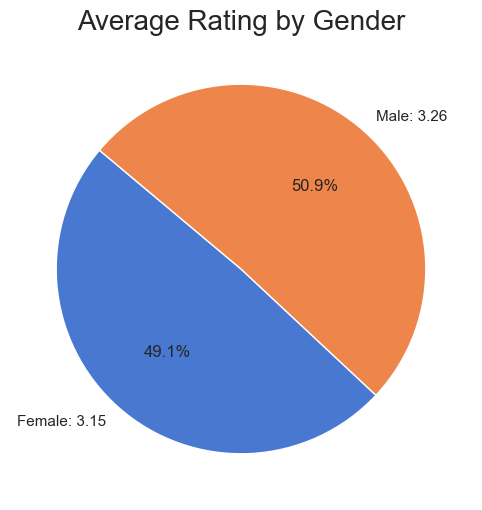

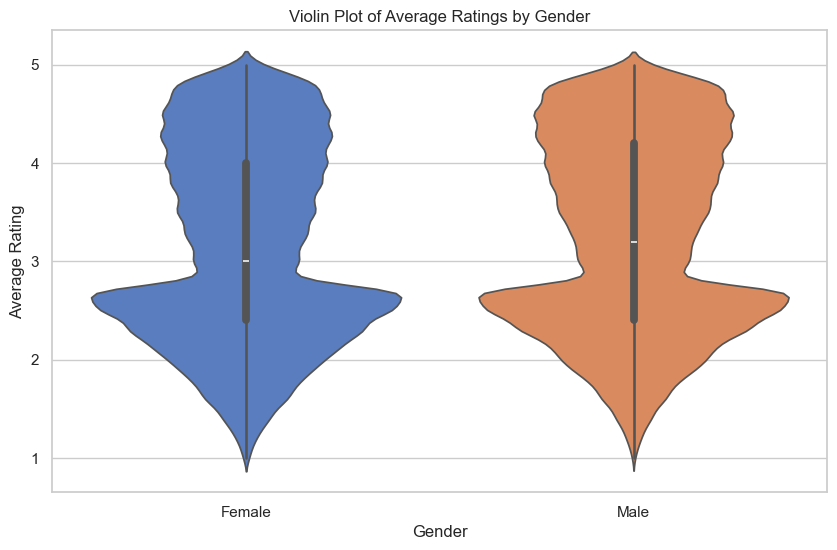

15484

In [38]:
# Average ratings by gender
gender_ratings = df.groupby('gender')['avg_rating'].mean().reset_index()

# Round the average ratings to 2 decimal places
gender_ratings['avg_rating'] = gender_ratings['avg_rating'].round(2)

# Plot average ratings by gender using Pie Chart
plt.figure(figsize=(8, 6))
plt.pie(
    gender_ratings['avg_rating'], 
    labels=[f"{row['gender']}: {row['avg_rating']}" for _, row in gender_ratings.iterrows()],
    autopct='%1.1f%%',
    startangle=140,
    colors=sns.color_palette('muted')
)

# Add title
plt.title('Average Rating by Gender', fontsize=20)

# Show the plot
plt.show()

# Create the violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(x='gender', y='avg_rating', data=df, inner='box', palette='muted')

# Add title and labels
plt.title('Violin Plot of Average Ratings by Gender')
plt.xlabel('Gender')
plt.ylabel('Average Rating')

# Show the plot
plt.show()

# Delete variables to clear memory and collect garbage
del gender_ratings
gc.collect()

<a id='gender-distribution-in-top-bottom-disciplines'></a>
### B. Gender Distribution in Top/Bottom Disciplines

Examines the gender distribution of professors within the top and bottom rated disciplines and sub-disciplines. This helps identify whether any gender imbalances exist at the extremes of rating distributions.

In [39]:
# Calculate average ratings by sub-discipline and sort
discipline_avg = df.groupby('discipline')['avg_rating'].mean().sort_values(ascending=False)

# Identify bottom 10 and top 10 sub-disciplines based on average ratings
top_3_disciplines = discipline_avg.head(3).index
bottom_3_disciplines = discipline_avg.tail(3).index

# Calculate average ratings by sub-discipline and sort
sub_discipline_avg = df.groupby('sub_discipline')['avg_rating'].mean().sort_values(ascending=False)

# Identify bottom 10 and top 10 sub-disciplines based on average ratings
top_10_sub_disciplines = sub_discipline_avg.head(10).index
bottom_10_sub_disciplines = sub_discipline_avg.tail(10).index


In [40]:
def create_frequency_df(data, column, values):
    """
    Creates a frequency DataFrame filtered by specified values and calculates gender-based statistics.
    """
    freq = data[data[column].isin(values)].groupby([column, 'gender']).size().unstack(fill_value=0)
    freq['Total'] = freq['Female'] + freq['Male']
    freq['Female %'] = ((freq['Female'] / freq['Total'] * 100).round(2)).astype(str) + '%'
    freq['Male %'] = ((freq['Male'] / freq['Total'] * 100).round(2)).astype(str) + '%'
    freq = freq.reset_index()
    freq.columns.name = None

    # Sort the DataFrame in ascending order based on 'Total'
    freq = freq.sort_values(by='Total', ascending=False)
    
    return freq

def add_table(fig, data, row, col, col_name):
    """
    Adds a styled table with alternating row colors to the specified subplot.
    """
    # Define the number of rows for alternating color calculation
    num_rows = len(data)
    
    # Generate alternating row colors: white and light gray
    row_colors = ['white' if i % 2 == 0 else 'lightgray' for i in range(num_rows)]
    
    # Define color palette for 'Female' and 'Male' columns
    color_palette = {"Female": "#FF9999", "Male": "#66B3FF"}
    
    # Add table to figure
    fig.add_trace(
        go.Table(
            header=dict(
                values=[col_name, 'Total', 'Female', 'Male', 'Female %', 'Male %'],
                fill_color='paleturquoise',
                align='center',
                font=dict(size=12, color='black')
            ),
            cells=dict(
                values=[
                    data[col_name],
                    data['Total'],
                    data['Female'],
                    data['Male'],
                    data['Female %'],
                    data['Male %']
                ],
                # Apply alternating colors to 'discipline/sub_discipline' and 'Total' columns, and color palette to 'Female' and 'Male' columns
                fill_color=[
                    row_colors,  # Discipline/Sub-discipline column
                    row_colors,  # Total column
                    [color_palette["Female"]] * num_rows,  # Female column
                    [color_palette["Male"]] * num_rows,  # Male column
                    [color_palette["Female"]] * num_rows,  # Female column
                    [color_palette["Male"]] * num_rows,  # Male column
                ],
                align='center',
                font=dict(size=11, color='black'),
                height=30
            )
        ),
        row=row, col=col
    )

# Assuming the following variables are defined:
# data, top_3_disciplines, bottom_3_disciplines, top_10_sub_disciplines, bottom_10_sub_disciplines

# Create frequency DataFrames with sorted data
top_3_discipline_freq = create_frequency_df(df, 'discipline', top_3_disciplines)
bottom_3_discipline_freq = create_frequency_df(df, 'discipline', bottom_3_disciplines)
top_10_sub_discipline_freq = create_frequency_df(df, 'sub_discipline', top_10_sub_disciplines)
bottom_10_sub_discipline_freq = create_frequency_df(df, 'sub_discipline', bottom_10_sub_disciplines)

# Create first figure for disciplines
fig1 = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Top 3 Rated Disciplines", "Bottom 3 Rated Disciplines"),
    horizontal_spacing=0.05,
    specs=[[{'type': 'table'}, {'type': 'table'}]]
)

# Add tables to the first figure
add_table(fig1, top_3_discipline_freq, 1, 1, 'discipline')
add_table(fig1, bottom_3_discipline_freq, 1, 2, 'discipline')

# Update layout for the first figure
fig1.update_layout(
    title_text="Discipline Frequency Analysis by Gender",
    height=250,
    width=1400,
    showlegend=False,
    margin=dict(l=50, r=50, t=80, b=50)
)

# Create second figure for sub-disciplines
fig2 = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Top 10 Rated Sub-disciplines", "Bottom 10 Rated Sub-disciplines"),
    horizontal_spacing=0.05,
    specs=[[{'type': 'table'}, {'type': 'table'}]]
)

# Add tables to the second figure
add_table(fig2, top_10_sub_discipline_freq, 1, 1, 'sub_discipline')
add_table(fig2, bottom_10_sub_discipline_freq, 1, 2, 'sub_discipline')

# Update layout for the second figure
fig2.update_layout(
    title_text="Sub-discipline Frequency Analysis by Gender",
    height=600,
    width=1400,
    showlegend=False,
    margin=dict(l=50, r=50, t=80, b=50)
)

# Display the figures
fig1.show()
fig2.show()

# Collect garbage
gc.collect()

359

<a id='gender-and-average-ratings-in-top-bottom-disciplines'></a>
### C. Gender and Average Ratings in Top/Bottom Disciplines

Analyzes how average ratings differ by gender specifically within the top-rated and bottom-rated disciplines and sub-disciplines. This is visualized using grouped bar plots, where each bar represents the average rating for a gender within a specific discipline or sub-discipline. This focused analysis can reveal if gender-based rating disparities are more pronounced in certain subject areas.

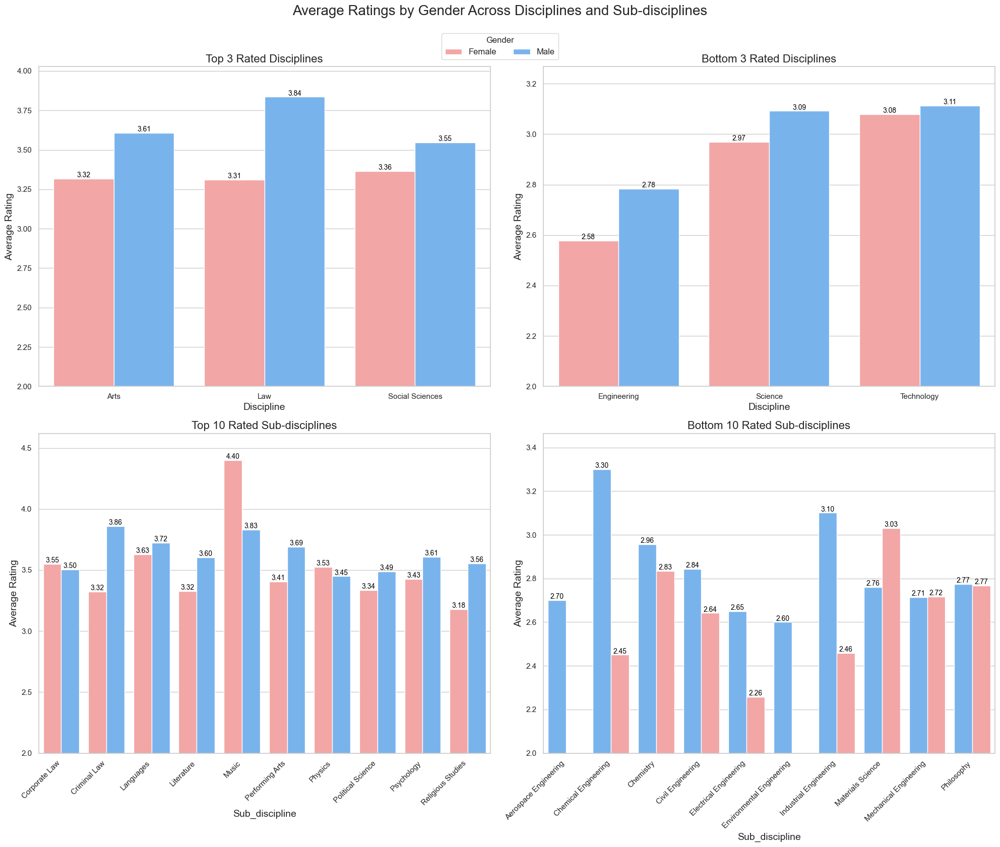

1221

In [41]:
sub_disc_df = df.copy()

# Calculate average ratings by gender for top and bottom disciplines
top_disc_avg = sub_disc_df[sub_disc_df['discipline'].isin(top_3_disciplines)].groupby(['discipline', 'gender'])['avg_rating'].mean().reset_index()
bottom_disc_avg = sub_disc_df[sub_disc_df['discipline'].isin(bottom_3_disciplines)].groupby(['discipline', 'gender'])['avg_rating'].mean().reset_index()

# Calculate average ratings by gender for top and bottom sub-disciplines
top_sub_disc_avg = sub_disc_df[sub_disc_df['sub_discipline'].isin(top_10_sub_disciplines)].groupby(['sub_discipline', 'gender'])['avg_rating'].mean().reset_index()
bottom_sub_disc_avg = sub_disc_df[sub_disc_df['sub_discipline'].isin(bottom_10_sub_disciplines)].groupby(['sub_discipline', 'gender'])['avg_rating'].mean().reset_index()

# Filter out 0.0 values
for sub_disc_df in [top_disc_avg, bottom_disc_avg, top_sub_disc_avg, bottom_sub_disc_avg]:
    sub_disc_df = sub_disc_df[sub_disc_df['avg_rating'] > 0]

# Set up the matplotlib figure with a grid of 2x2
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
sns.set(style="whitegrid")

# Define a consistent color palette
color_palette = {"Female": "#FF9999", "Male": "#66B3FF"}

# Function to create and annotate barplots
def create_barplot(data, x, y, hue, ax, title):
    sns.barplot(data=data, x=x, y=y, hue=hue, palette=color_palette, ax=ax)
    ax.set_title(title, fontsize=16)
    ax.set_xlabel(x.capitalize(), fontsize=14)
    ax.set_ylabel('Average Rating', fontsize=14)
    ax.set_ylim(bottom=2.0)  # Set y-axis minimum to 2.0
    
    for p in ax.patches:
        ax.annotate(f'{p.get_height():.2f}', 
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=10, color='black',
                    xytext=(0, 5), textcoords='offset points')
    
    ax.legend_.remove()  # Remove individual legends

# Create barplots
create_barplot(top_disc_avg, 'discipline', 'avg_rating', 'gender', axes[0, 0], 'Top 3 Rated Disciplines')
create_barplot(bottom_disc_avg, 'discipline', 'avg_rating', 'gender', axes[0, 1], 'Bottom 3 Rated Disciplines')
create_barplot(top_sub_disc_avg, 'sub_discipline', 'avg_rating', 'gender', axes[1, 0], 'Top 10 Rated Sub-disciplines')
create_barplot(bottom_sub_disc_avg, 'sub_discipline', 'avg_rating', 'gender', axes[1, 1], 'Bottom 10 Rated Sub-disciplines')

# Rotate x-axis labels for sub-disciplines
axes[1, 0].set_xticklabels(axes[1, 0].get_xticklabels(), rotation=45, ha='right')
axes[1, 1].set_xticklabels(axes[1, 1].get_xticklabels(), rotation=45, ha='right')

# Adjust the layout
plt.tight_layout()

# Add a single legend for the entire figure
handles, labels = axes[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, title='Gender', loc='upper center', bbox_to_anchor=(0.5, 1.02), ncol=2, fontsize=12)

# Add an overall title
fig.suptitle('Average Ratings by Gender Across Disciplines and Sub-disciplines', fontsize=20, y=1.05)

plt.show()

# Delete variables to clear memory and collect garbage
del sub_disc_df, top_disc_avg, bottom_disc_avg, top_sub_disc_avg, bottom_sub_disc_avg, fig, axes
del discipline_avg, sub_discipline_avg
del top_3_disciplines, bottom_3_disciplines, top_10_sub_disciplines, bottom_10_sub_disciplines
del top_3_discipline_freq, bottom_3_discipline_freq, top_10_sub_discipline_freq, bottom_10_sub_discipline_freq
del fig1, fig2

gc.collect()

In [42]:
df[['professor_id', 'first_name', 'last_name', 'gender', 'avg_rating',
        'discipline', 'sub_discipline', 'department', 
        'would_take_again_percent', 
        'rating_comment', 'rating_flagStatus', 'rating_class',
        'rating_helpfulRating', 'rating_clarityRating',
        'rating_isForOnlineClass', 'rating_difficultyRating',
        'rating_isForCredit', 
        'processed_comment', 'sentiment', 'positive_terms_lexicon',
        'negative_terms_lexicon', 'positive_terms_vader',
        'negative_terms_vader']].to_csv("RMP SET.csv", index=False)
del df
gc.collect()

0

<a id='topic-modeling-of-student-comments'></a>
# 9. Topic Modeling of Student Comments

Latent Dirichlet Allocation (LDA) is used to discover underlying topics within the preprocessed student comments.  The code includes functions for optimal topic number selection based on coherence score, model training, and visualization of topic distributions.

In [43]:
def read_data_in_chunks(file_path, chunk_size=50000):
    """Read CSV file in chunks to prevent memory overload"""
    return pd.read_csv(file_path, chunksize=chunk_size)

def convert_to_list(text):
    """Safely convert text to list if needed"""
    if isinstance(text, str):
        try:
            return eval(text)
        except:
            return []
    return text if isinstance(text, list) else []

def create_dictionary_from_chunks(file_path, chunk_size=50000):
    """Create dictionary incrementally from text chunks"""
    dictionary = corpora.Dictionary()
    chunks = read_data_in_chunks(file_path, chunk_size)
    
    for chunk in tqdm(chunks, desc="Building dictionary"):
        texts = chunk['processed_comment'].apply(convert_to_list).tolist()
        texts = [text for text in texts if isinstance(text, list) and len(text) > 0]
        if texts:
            dictionary.add_documents(texts)
        
        # Clear memory
        del texts
        gc.collect()
    
    # Filter extremes after processing all documents
    dictionary.filter_extremes(no_below=5, no_above=0.5)
    return dictionary

def process_chunk_to_corpus(chunk, dictionary):
    """Convert a chunk of texts to corpus format"""
    texts = chunk['processed_comment'].apply(convert_to_list).tolist()
    texts = [text for text in texts if isinstance(text, list) and len(text) > 0]
    corpus = [dictionary.doc2bow(text) for text in texts]
    return [doc for doc in corpus if len(doc) > 0], texts

def compute_coherence_scores(dictionary, file_path, num_topics_range, chunk_size=50000):
    """Compute coherence scores using a subset of data"""
    # Use only first chunk for coherence computation
    first_chunk = next(read_data_in_chunks(file_path, chunk_size))
    corpus, texts = process_chunk_to_corpus(first_chunk, dictionary)
    
    # Use a smaller subset for coherence calculation
    subset_size = min(10000, len(corpus))
    corpus_subset = corpus[:subset_size]
    texts_subset = texts[:subset_size]
    
    coherence_values = []
    
    for num_topics in tqdm(num_topics_range, desc="Computing coherence scores"):
        try:
            model = LdaMulticore(
                corpus=corpus_subset,
                num_topics=num_topics,
                id2word=dictionary,
                random_state=42,
                passes=2,  # Reduced passes for faster processing
                workers=7,  # Using most of available cores
                chunksize=2000
            )
            
            coherencemodel = CoherenceModel(
                model=model,
                texts=texts_subset,
                dictionary=dictionary,
                coherence='c_v',
                processes=7
            )
            
            coherence = coherencemodel.get_coherence()
            coherence_values.append(coherence)
            
            # Clear memory
            del model, coherencemodel
            gc.collect()
            
        except Exception as e:
            print(f"Error for num_topics={num_topics}: {e}")
            coherence_values.append(None)
    
    return coherence_values

def train_final_model(optimal_num_topics, dictionary, file_path, chunk_size=50000):
    """Train the final LDA model using chunks"""
    model = LdaMulticore(
        id2word=dictionary,
        num_topics=optimal_num_topics,
        random_state=42,
        passes=10,
        workers=7,
        chunksize=2000
    )
    
    # Train model incrementally
    chunks = read_data_in_chunks(file_path, chunk_size)
    for chunk in tqdm(chunks, desc="Training final model"):
        corpus, _ = process_chunk_to_corpus(chunk, dictionary)
        if corpus:
            model.update(corpus)
        
        # Clear memory
        del corpus
        gc.collect()
    
    return model

def process_and_save_results(model, dictionary, file_path, output_path, chunk_size=50000):
    """Process results and save in chunks"""
    chunks = read_data_in_chunks(file_path, chunk_size)
    first_chunk = True
    
    for chunk_index, chunk in enumerate(tqdm(chunks, desc="Processing results")):
        corpus, _ = process_chunk_to_corpus(chunk, dictionary)
        
        # Get dominant topics
        dominant_topics = []
        for doc in corpus:
            topic_dist = model.get_document_topics(doc)
            dominant_topic = max(topic_dist, key=lambda x: x[1]) if topic_dist else (-1, 0)
            topic_keywords = ", ".join([word for word, _ in model.show_topic(dominant_topic[0])])
            dominant_topics.append((dominant_topic[0], dominant_topic[1], topic_keywords))
        
        # Create results DataFrame
        df_topics = pd.DataFrame(dominant_topics, columns=['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords'])
        results = pd.concat([chunk.reset_index(drop=True), df_topics], axis=1)
        
        # Save chunk
        mode = 'w' if first_chunk else 'a'
        header = first_chunk
        results.to_csv(output_path, mode=mode, header=header, index=False)
        first_chunk = False
        
        # Clear memory
        del corpus, dominant_topics, df_topics, results
        gc.collect()

def main_pipeline(input_file, output_file):
    """Main processing pipeline with memory optimization"""
    # Step 1: Create dictionary
    print("Creating dictionary...")
    dictionary = create_dictionary_from_chunks(input_file)
    print(f"Dictionary created with {len(dictionary)} terms")
    
    # Step 2: Find optimal number of topics
    print("Computing coherence scores...")
    topic_range = range(3, 12, 1)
    coherence_values = compute_coherence_scores(dictionary, input_file, topic_range)
    
    # Plot coherence scores
    if any(cv is not None for cv in coherence_values):
        plt.figure(figsize=(10, 6))
        plt.plot(topic_range, coherence_values, marker='o')
        plt.xlabel('Number of Topics')
        plt.ylabel('Coherence Score')
        plt.title('Coherence Scores by Number of Topics')
        plt.grid(True)
        plt.show()
        
        optimal_num_topics = topic_range[np.argmax(coherence_values)]
        print(f"Optimal number of topics: {optimal_num_topics}")
        
        # Step 3: Train final model
        print("Training final model...")
        optimal_model = train_final_model(optimal_num_topics, dictionary, input_file)
        
        # Save model and dictionary
        print("Saving model and dictionary...")
        with open('lda_model_optimized.pkl', 'wb') as f:
            pickle.dump(optimal_model, f)
        with open('dictionary_optimized.pkl', 'wb') as f:
            pickle.dump(dictionary, f)
        
        # Step 4: Process and save results
        print("Processing and saving results...")
        process_and_save_results(optimal_model, dictionary, input_file, output_file)
        
        return optimal_model, dictionary
    else:
        print("No valid coherence values computed")
        return None, None


Creating dictionary...



Building dictionary: 0it [00:00, ?it/s]


Building dictionary: 1it [00:06,  6.98s/it]


Building dictionary: 2it [00:13,  6.99s/it]


Building dictionary: 3it [00:20,  7.00s/it]


Building dictionary: 4it [00:28,  7.03s/it]


Building dictionary: 5it [00:35,  7.05s/it]


Building dictionary: 6it [00:42,  7.04s/it]


Building dictionary: 7it [00:49,  7.03s/it]


Building dictionary: 8it [00:56,  7.03s/it]


Building dictionary: 9it [01:03,  7.03s/it]


Building dictionary: 10it [01:10,  7.02s/it]


Building dictionary: 11it [01:17,  7.03s/it]


Building dictionary: 12it [01:24,  7.03s/it]


Building dictionary: 13it [01:31,  7.03s/it]


Building dictionary: 14it [01:38,  7.04s/it]


Building dictionary: 15it [01:45,  7.04s/it]


Building dictionary: 16it [01:52,  7.04s/it]


Building dictionary: 17it [01:59,  7.04s/it]


Building dictionary: 18it [02:06,  7.05s/it]


Building dictionary: 19it [02:13,  7.05s/it]


Building dictionary: 20it [02:20,  7.06s/it]


Building dictionary: 21it [02:27,  7.08s/it]


Building dictionary: 22it [02:34,  7.09s/it]


Building dictionary: 23it [02:42,  7.09s/it]


Building dictionary: 24it [02:49,  7.10s/it]


Building dictionary: 25it [02:56,  7.12s/it]


Building dictionary: 26it [03:03,  7.14s/it]


Building dictionary: 27it [03:10,  7.15s/it]


Building dictionary: 28it [03:17,  7.13s/it]


Building dictionary: 29it [03:24,  7.11s/it]


Building dictionary: 30it [03:31,  7.02s/it]


Building dictionary: 30it [03:31,  7.06s/it]

Dictionary created with 51810 terms
Computing coherence scores...



Computing coherence scores:   0%|                                                                | 0/9 [00:00<?, ?it/s]


Computing coherence scores:  11%|██████▏                                                 | 1/9 [00:19<02:35, 19.45s/it]


Computing coherence scores:  22%|████████████▍                                           | 2/9 [00:37<02:10, 18.65s/it]


Computing coherence scores:  33%|██████████████████▋                                     | 3/9 [00:55<01:50, 18.45s/it]


Computing coherence scores:  44%|████████████████████████▉                               | 4/9 [01:14<01:32, 18.40s/it]


Computing coherence scores:  56%|███████████████████████████████                         | 5/9 [01:33<01:14, 18.72s/it]


Computing coherence scores:  67%|█████████████████████████████████████▎                  | 6/9 [01:51<00:55, 18.60s/it]


Computing coherence scores:  78%|███████████████████████████████████████████▌            | 7/9 [02:09<00:36, 18.44s/it]


Computing coherence scores:  89%|█████████████████████████████████████████████████▊      | 8/9 [02:27<00:18, 18.32s/it]


Computing coherence scores: 100%|████████████████████████████████████████████████████████| 9/9 [02:46<00:00, 18.26s/it]


Computing coherence scores: 100%|████████████████████████████████████████████████████████| 9/9 [02:46<00:00, 18.45s/it]

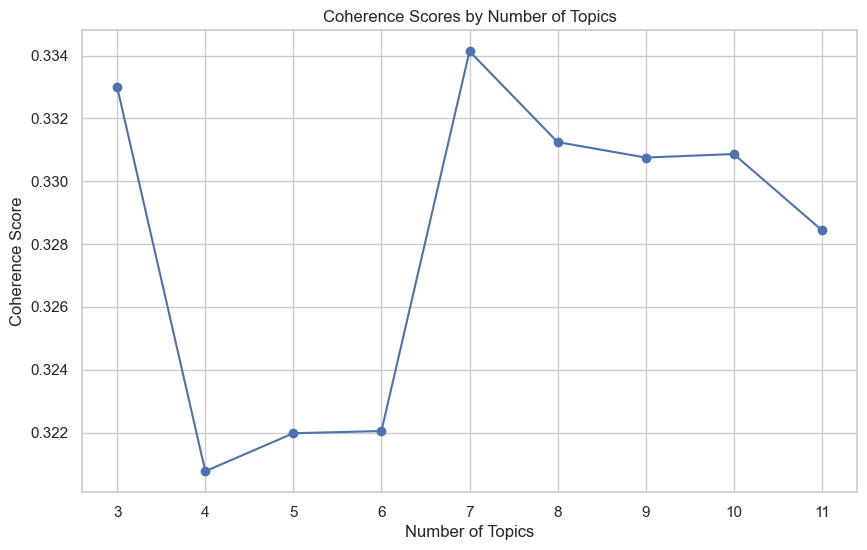

Optimal number of topics: 7
Training final model...



Training final model: 0it [00:00, ?it/s]


Training final model: 1it [00:36, 36.93s/it]


Training final model: 2it [01:09, 34.58s/it]


Training final model: 3it [01:42, 33.58s/it]


Training final model: 4it [02:13, 32.59s/it]


Training final model: 5it [02:44, 32.12s/it]


Training final model: 6it [03:14, 31.48s/it]


Training final model: 7it [03:45, 31.35s/it]


Training final model: 8it [04:18, 31.79s/it]


Training final model: 9it [04:50, 31.90s/it]


Training final model: 10it [05:22, 31.88s/it]


Training final model: 11it [05:53, 31.66s/it]


Training final model: 12it [06:24, 31.24s/it]


Training final model: 13it [06:54, 31.05s/it]


Training final model: 14it [07:25, 31.07s/it]


Training final model: 15it [07:57, 31.23s/it]


Training final model: 16it [08:28, 31.20s/it]


Training final model: 17it [08:58, 30.87s/it]


Training final model: 18it [09:28, 30.60s/it]


Training final model: 19it [09:58, 30.41s/it]


Training final model: 20it [10:29, 30.58s/it]


Training final model: 21it [11:00, 30.76s/it]


Training final model: 22it [11:31, 30.63s/it]


Training final model: 23it [12:01, 30.51s/it]


Training final model: 24it [12:31, 30.47s/it]


Training final model: 25it [13:02, 30.47s/it]


Training final model: 26it [13:33, 30.63s/it]


Training final model: 27it [14:03, 30.64s/it]


Training final model: 28it [14:34, 30.73s/it]


Training final model: 29it [15:04, 30.32s/it]


Training final model: 30it [15:27, 28.25s/it]


Training final model: 30it [15:27, 30.92s/it]

Saving model and dictionary...
Processing and saving results...



Processing results: 0it [00:00, ?it/s]


Processing results: 1it [00:47, 47.67s/it]


Processing results: 2it [01:35, 47.63s/it]


Processing results: 3it [02:23, 47.95s/it]


Processing results: 4it [03:11, 47.85s/it]


Processing results: 5it [03:58, 47.75s/it]


Processing results: 6it [04:46, 47.75s/it]


Processing results: 7it [05:34, 47.86s/it]


Processing results: 8it [06:22, 47.94s/it]


Processing results: 9it [07:10, 48.01s/it]


Processing results: 10it [07:58, 47.93s/it]


Processing results: 11it [08:49, 48.82s/it]


Processing results: 12it [09:37, 48.59s/it]


Processing results: 13it [10:26, 48.56s/it]


Processing results: 14it [11:14, 48.57s/it]


Processing results: 15it [12:03, 48.58s/it]


Processing results: 16it [12:57, 50.13s/it]


Processing results: 17it [13:49, 50.75s/it]


Processing results: 18it [14:43, 51.84s/it]


Processing results: 19it [15:36, 52.24s/it]


Processing results: 20it [16:29, 52.47s/it]


Processing results: 21it [17:26, 53.83s/it]


Processing results: 22it [18:20, 53.93s/it]


Processing results: 23it [19:18, 54.94s/it]


Processing results: 24it [20:05, 52.66s/it]


Processing results: 25it [20:53, 51.29s/it]


Processing results: 26it [21:51, 53.19s/it]


Processing results: 27it [22:44, 53.05s/it]


Processing results: 28it [23:36, 52.86s/it]


Processing results: 29it [24:28, 52.65s/it]


Processing results: 30it [25:16, 51.11s/it]


Processing results: 30it [25:16, 50.54s/it]

In [44]:
input_file = "RMP SET.csv"
output_file = "topic_results.csv"
optimal_model, dictionary = main_pipeline(input_file, output_file)

In [45]:
results_df = pd.read_csv('topic_results.csv')

tools.display_dataframe_to_user("Topic Modeling", results_df)

Topic Modeling


In [46]:
# Load the LDA model
with open('lda_model.pkl', 'rb') as file:
    loaded_lda_model = pickle.load(file)

# Load the dictionary
with open('dictionary.pkl', 'rb') as file:
    loaded_dictionary = pickle.load(file)

print("Model, dictionary, and topic results loaded successfully!")

Model, dictionary, and topic results loaded successfully!


In [47]:
loaded_dictionary.most_common()

[('take', 688826),
 ('make', 360737),
 ('test', 354049),
 ('get', 345794),
 ('grade', 341869),
 ('good', 324238),
 ('easy', 308762),
 ('give', 285716),
 ('student', 266232),
 ('hard', 260056),
 ('really', 255675),
 ('lecture', 253285),
 ('work', 246961),
 ('time', 246600),
 ('would', 244040),
 ('well', 236577),
 ('go', 234754),
 ('lot', 234182),
 ('exam', 233590),
 ('help', 224608),
 ('teach', 223923),
 ('question', 223413),
 ('great', 218525),
 ('one', 201261),
 ('assignment', 196590),
 ('like', 196587),
 ('learn', 195208),
 ('know', 188690),
 ('read', 175386),
 ('understand', 163647),
 ('quiz', 162124),
 ('study', 160620),
 ('material', 157602),
 ('want', 155970),
 ('homework', 155679),
 ('bad', 149335),
 ('ever', 140586),
 ('recommend', 139563),
 ('need', 139011),
 ('much', 128993),
 ('nice', 126419),
 ('online', 126174),
 ('even', 124913),
 ('also', 122631),
 ('every', 119171),
 ('care', 119125),
 ('final', 118400),
 ('never', 116391),
 ('ask', 116078),
 ('book', 114984),
 ('paper'

In [48]:
# Display the topics generated by the LDA model
topics = loaded_lda_model.show_topics(num_topics=10, num_words=20, formatted=False)

# Print the topics
for topic_num, words in topics:
    print(f"Topic {topic_num}:")
    print(", ".join([word for word, _ in words]))
    print("\n")

Topic 0:
question, answer, ask, teach, explain, understand, email, lecture, material, help, time, go, problem, make, homework, hour, would, hard, math, know


Topic 1:
take, recommend, would, one, good, class, ever, professor, well, math, major, highly, love, easy, s, he, definitely, far, favorite, make


Topic 2:
really, lecture, make, nice, easy, guy, good, lot, like, interesting, talk, hard, know, boring, learn, get, pretty, great, go, read


Topic 3:
student, help, work, care, good, well, really, want, learn, lot, great, make, put, always, willing, give, understand, need, effort, hard


Topic 4:
assignment, grade, week, work, paper, take, give, project, time, due, get, group, write, final, online, every, essay, quiz, read, semester


Topic 5:
test, exam, study, quiz, hard, take, grade, lecture, note, give, get, read, homework, easy, book, final, go, credit, question, good


Topic 6:
take, bad, student, ever, teach, get, like, never, make, avoid, say, know, grade, even, time, would,

<a id='conclusion'></a>
# 10. Conclusion

This notebook provides a detailed analysis of the RateMyProfessor dataset, encompassing data cleaning, feature engineering, statistical analysis, bias detection, sentiment analysis, and topic modeling. The results shed light on various aspects of professor evaluations, including potential biases and prevalent themes in student feedback.  This analysis can be further extended for more in-depth research and development of fairer evaluation systems.